# Dataset preparation notebook
This notebook is responsible for generating all datasets that are actually used by our models.
Splits prepared tifs, background masks, and annotation numpy arrays into 256x256 patches, with specified overlap.

The notebook itself is split into 4 parts.
1. Extraction of training data for the supporting cell segmentation model.
2. Extraction of training data for the original U-Net based multiclass structure segmentation model.
3. Extraction of training data for our novel attention based multilabeling structure segmentation model.
4. Preparation of testing data for all cases.

Mask extraction notebook should be run first, to process .vsi and .geojson files.

In [2]:
import os
import numpy as np
import tifffile as tiff
import geopandas as gpd
import re
import fiona
import cv2
import time
import joblib

from skimage.draw import polygon
from shapely.geometry import Polygon, mapping
from glob import glob
from sklearn.preprocessing import StandardScaler
from multiprocess import Pool
from matplotlib import pyplot as plt

# Train data - support cell segmentation model

First simple data extraction.

256 x 256 patches, 50% overlap, no additional data. Stores RGB patches + background mask for the relevant patch and annotations of the cells.
This extraction can be used for training both a binary cell segmentation model and a multiclass cell segmentation model.

In [3]:
wsi_patt = './tif_export/{idx}.ome.tif'
bg_patt = './bg_masks/{idx}_bg.npy'
class_patt = './cell_masks/{idx}_cells.npy'

In [13]:
# Output shape 5x256x256; RGB BG CLASS
# idx => corresponding .tif 
# x, y => upper-left corner coordinates
out_store = './cell_training_data/{idx}_x={x}_y={y}.npy'

def extract_training_set(idx, tiff=tiff, np=np, out_store=out_store, wsi_patt=wsi_patt, bg_patt=bg_patt, class_patt=class_patt):
    output = []
    window_size = 256
    stride = 128

    if idx in [3002, 7026]:
        wsi_data = tiff.imread(wsi_patt.replace('.ome', '').format(idx=str(idx)+'-test'))
        bg_data = np.load(bg_patt.replace('.ome', '').format(idx=str(idx)+'-test'))
    else:
        wsi_data = tiff.imread(wsi_patt.format(idx=idx))
        bg_data = np.load(bg_patt.format(idx=idx))
    class_data = np.load(class_patt.format(idx=idx))
    
    splits = []
    for x in range(0, wsi_data.shape[0], stride):
        for y in range(0, wsi_data.shape[1], stride):
            if min(wsi_data.shape[1], y + window_size) - y != 256:
                y = 256 - (min(wsi_data.shape[1], y + window_size) - y)
            if min(wsi_data.shape[0], x + window_size) - x != 256:
                x = 256 - (min(wsi_data.shape[1], x + window_size) - x)
            
            if np.count_nonzero(bg_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]==0) >= 50:
                out_arr = np.zeros((5, 256, 256))
                out_arr[:3, :, :] = np.transpose(wsi_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)], (2, 0, 1))
                out_arr[3, :, :] = bg_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[4, :, :] = class_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                
                with open(out_store.format(idx=idx, x=x, y=y), 'wb') as f:
                    np.save(f, out_arr.astype(np.uint8))
    return output

In [14]:
idx_list = [int(idx.split('_')[0]) for idx in os.listdir('cell_masks') if 'test' not in idx] 

In [15]:
for idx in idx_list:
    extract_training_set(idx)

In [ ]:
%%time
for x in range(np.ceil(len(idx_list)/2).astype(np.uint8)):
    with Pool(2) as p:
        results = p.map(extract_training_set,  idx_list[x*2:(x+1)*2])

    for res in results:
        for data in res:
            with open(out_store.format(idx=data[0], x=data[1], y=data[2]), 'wb') as f:
                np.save(f, data[3].astype(np.uint8))

# Train data - Multiclass segmentation

## Binary supporting information training data

In [39]:
wsi_patt = './raw_data/tif_export/{idx}.ome.tif'
bg_patt = './raw_data/bg_masks/{idx}_bg.npy'
class_patt = './raw_data/class_masks_fix/{idx}_classes.npy'
nuclei_patt = './raw_data/cell_masks/{idx}_cells.npy'

In [19]:
# Output shape 5x256x256; RGB BG CLASS
# idx => corresponding .tif 
# x, y => upper-left corner coordinates
out_store = './training_data/lab/binary_cells/{idx}_x={x}_y={y}.npy'

def extract_binary_training_set(idx, tiff=tiff, np=np, out_store=out_store, wsi_patt=wsi_patt, bg_patt=bg_patt, class_patt=class_patt):
    output = []
    window_size = 256
    stride = 128

    wsi_data = tiff.imread(wsi_patt.format(idx=idx))
    wsi_data = cv2.cvtColor(wsi_data, cv2.COLOR_RGB2LAB)
    wsi_data = cv2.resize(wsi_data, (wsi_data.shape[1]//2, wsi_data.shape[0]//2))
    
    bg_data = np.load(bg_patt.format(idx=idx))
    bg_data = cv2.resize(bg_data, (bg_data.shape[1]//2, bg_data.shape[0]//2))
    
    class_data = np.load(class_patt.format(idx=idx))
    class_data = cv2.resize(class_data, (class_data.shape[1]//2, class_data.shape[0]//2))
    
    cell_data = np.load(nuclei_patt.format(idx=idx))
    dst_data = np.where(cell_data >= 1, 0, 1).astype(np.uint8)
    cell_data = np.where(cell_data >= 1, 1, 0).astype(np.uint8)
    cell_data = cv2.resize(cell_data, (cell_data.shape[1]//2, cell_data.shape[0]//2))
    
    dst = cv2.distanceTransform(dst_data, cv2.DIST_L2, 3)
    dst = np.where(dst>255, 255, dst)
    dst = cv2.resize(dst, (dst.shape[1]//2, dst.shape[0]//2))
    
    splits = []
    for x in range(0, wsi_data.shape[0], stride):
        for y in range(0, wsi_data.shape[1], stride):
            if min(wsi_data.shape[1], y + window_size) - y != 256:
                y = 256 - (min(wsi_data.shape[1], y + window_size) - y)
            if min(wsi_data.shape[0], x + window_size) - x != 256:
                x = 256 - (min(wsi_data.shape[1], x + window_size) - x)
            
            if np.count_nonzero(bg_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]==0) >= 50:
                out_arr = np.zeros((7, 256, 256))
                
                out_arr[:3, :, :] = np.transpose(wsi_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)], (2, 0, 1))
                out_arr[3, :, :] = bg_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[4, :, :] = class_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[5, :, :] = cell_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[6, :, :] = dst[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                
                with open(out_store.format(idx=idx, x=x, y=y), 'wb') as f:
                    np.save(f, out_arr.astype(np.uint8))
    return output

In [20]:
idx_list = [int(idx.split('.')[0]) for idx in os.listdir('./raw_data/tif_export') if 'test' not in idx] 

In [21]:
idx_list = [x for x in idx_list if x not in [2724, 2940]]

In [22]:
%%time
for idx in idx_list:
    extract_binary_training_set(idx)

CPU times: total: 5min 32s
Wall time: 8min 52s


### Binary training data extraction from WSIs where cells are predicted using the supporting model

In [27]:
# Output shape 5x256x256; RGB BG CLASS
# idx => corresponding .tif 
# x, y => upper-left corner coordinates
out_store = './training_data/lab/binary_cells/{idx}_x={x}_y={y}.npy'

def extract_binary_training_set(file, tiff=tiff, np=np, out_store=out_store, wsi_patt=wsi_patt, bg_patt=bg_patt, class_patt=class_patt):
    output = []
    window_size = 256
    stride = 128

    idx = int(file.split('_')[0])
    data = np.load(f'./test_data/cell/nuclei_binary/{file}')
    
    wsi_data = data[:3, :, :]
    wsi_data = cv2.cvtColor(wsi_data.transpose((1, 2, 0)), cv2.COLOR_RGB2LAB).transpose((2, 0, 1))
    wsi_data = cv2.resize(wsi_data.transpose((1, 2, 0)), (wsi_data.shape[2]//2, wsi_data.shape[1]//2))
    
    bg_data = data[3, :, :]
    bg_data = cv2.resize(bg_data, (bg_data.shape[1]//2, bg_data.shape[0]//2))
    
    class_data = data[4, :, :]
    class_data = cv2.resize(class_data, (class_data.shape[1]//2, class_data.shape[0]//2))
    
    cell_data = data[5, :, :]
    dst_data = np.where(cell_data >= 1, 0, 1).astype(np.uint8)
    cell_data = np.where(cell_data >= 1, 1, 0).astype(np.uint8)
    cell_data = cv2.resize(cell_data, (cell_data.shape[1]//2, cell_data.shape[0]//2))
    
    dst = cv2.distanceTransform(dst_data, cv2.DIST_L2, 3)
    dst = np.where(dst>255, 255, dst)
    dst = cv2.resize(dst, (dst.shape[1]//2, dst.shape[0]//2))
    
    splits = []
    for x in range(0, wsi_data.shape[0], stride):
        for y in range(0, wsi_data.shape[1], stride):
            if min(wsi_data.shape[1], y + window_size) - y != 256:
                y = 256 - (min(wsi_data.shape[1], y + window_size) - y)
            if min(wsi_data.shape[0], x + window_size) - x != 256:
                x = 256 - (min(wsi_data.shape[1], x + window_size) - x)
            
            if np.count_nonzero(bg_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]==0) >= 50:
                out_arr = np.zeros((7, 256, 256))
                
                out_arr[:3, :, :] = np.transpose(wsi_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)], (2, 0, 1))
                out_arr[3, :, :] = bg_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[4, :, :] = class_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[5, :, :] = cell_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[6, :, :] = dst[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                
                with open(out_store.format(idx=file.replace('.npy', ''), x=x, y=y), 'wb') as f:
                    np.save(f, out_arr.astype(np.uint8))
    return output

In [28]:
%%time
for file in os.listdir('F:/Halinkovic/IKEM/test_data/cell/binary'):
    extract_binary_training_set(file)

CPU times: total: 28 s
Wall time: 52.5 s


In [10]:
scaler_data = np.empty(shape=(len(glob('./training_data/lab/binary_cells/*.npy')), 256, 256))
for idx, file in enumerate(glob('./training_data/lab/binary_cells/*.npy')):
    scaler_data[idx, :, :] = np.load(file)[6]

In [11]:
scaler = StandardScaler().fit(scaler_data.reshape(-1, 1))

In [12]:
joblib.dump(scaler, "./training_data/lab/scalers/binary_dst_scaler.joblib")

['./training_data/lab/scalers/binary_dst_scaler.joblib']

## Multiclass supporting information training data

In [109]:
# Output shape 5x256x256; RGB BG CLASS
# idx => corresponding .tif 
# x, y => upper-left corner coordinates
out_store = './training_data/lab/separate_validation/multiclass_cells/{mode}/{idx}_x={x}_y={y}.npy'

def extract_multiclass_training_set(idx, tiff=tiff, np=np, cv2=cv2, out_store=out_store, wsi_patt=wsi_patt, bg_patt=bg_patt, class_patt=class_patt, nuclei_patt=nuclei_patt, mode='train'):
    output = []
    window_size = 256
    stride = 128
    

    wsi_data = tiff.imread(wsi_patt.format(idx=idx))
    wsi_data = cv2.cvtColor(wsi_data, cv2.COLOR_RGB2LAB)
    wsi_data = cv2.resize(wsi_data, (wsi_data.shape[1]//2, wsi_data.shape[0]//2))
    bg_data = np.load(bg_patt.format(idx=idx))
    bg_data = cv2.resize(bg_data, (bg_data.shape[1]//2, bg_data.shape[0]//2))
    class_data = np.load(class_patt.format(idx=idx))
    class_data = cv2.resize(class_data, (class_data.shape[1]//2, class_data.shape[0]//2))
    cell_data = np.load(nuclei_patt.format(idx=idx))
    
    cell_data_1 = np.where(cell_data == 1, 1, 0).astype(np.uint8)
    cell_data_2 = np.where(cell_data == 2, 1, 0).astype(np.uint8)
    cell_data_3 = np.where(cell_data == 3, 1, 0).astype(np.uint8)
    
    dst_data_1 = np.where(cell_data_1 == 1, 0, 1).astype(np.uint8)
    dst_data_2 = np.where(cell_data_2 == 1, 0, 1).astype(np.uint8)
    dst_data_3 = np.where(cell_data_3 == 1, 0, 1).astype(np.uint8)
    
    dst_1 = cv2.distanceTransform(dst_data_1, cv2.DIST_L2, 3)
    dst_2 = cv2.distanceTransform(dst_data_2, cv2.DIST_L2, 3)
    dst_3 = cv2.distanceTransform(dst_data_3, cv2.DIST_L2, 3)
    
    dst_1 = np.where(dst_1>255, 255, dst_1).astype(np.uint8)
    dst_2 = np.where(dst_2>255, 255, dst_2).astype(np.uint8)
    dst_3 = np.where(dst_3>255, 255, dst_3).astype(np.uint8)
    
    dst_1 = cv2.resize(dst_1, (dst_1.shape[1]//2, dst_1.shape[0]//2))
    dst_2 = cv2.resize(dst_2, (dst_2.shape[1]//2, dst_2.shape[0]//2))
    dst_3 = cv2.resize(dst_3, (dst_3.shape[1]//2, dst_3.shape[0]//2))
    
    cell_data_1 = cv2.resize(cell_data_1, (cell_data_1.shape[1]//2, cell_data_1.shape[0]//2))
    cell_data_2 = cv2.resize(cell_data_2, (cell_data_2.shape[1]//2, cell_data_2.shape[0]//2))
    cell_data_3 = cv2.resize(cell_data_3, (cell_data_3.shape[1]//2, cell_data_3.shape[0]//2))
    
    splits = []
    for x in range(0, wsi_data.shape[0], stride):
        for y in range(0, wsi_data.shape[1], stride):
            if min(wsi_data.shape[1], y + window_size) - y != 256:
                y = 256 - (min(wsi_data.shape[1], y + window_size) - y)
            if min(wsi_data.shape[0], x + window_size) - x != 256:
                x = 256 - (min(wsi_data.shape[1], x + window_size) - x)
            
            if np.count_nonzero(bg_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]==0) >= 5000:
                out_arr = np.zeros((11, 256, 256))
                
                out_arr[:3, :, :] = np.transpose(wsi_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)], (2, 0, 1))
                out_arr[3, :, :] = bg_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[4, :, :] = class_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[5, :, :] = cell_data_1[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[6, :, :] = dst_1[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[7, :, :] = cell_data_2[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[8, :, :] = dst_2[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[9, :, :] = cell_data_3[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[10, :, :] = dst_3[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                
                with open(out_store.format(mode=mode, idx=idx, x=x, y=y), 'wb') as f:
                    np.save(f, out_arr.astype(np.uint8))
                    
                if np.count_nonzero(class_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)] > 0) >= 6553:
                    
                    with open(out_store.format(mode=mode, idx=f'{idx}_ver', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(out_arr.astype(np.uint8), axis=1))
                    with open(out_store.format(mode=mode, idx=f'{idx}_hor', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(out_arr.astype(np.uint8), axis=2))
                    with open(out_store.format(mode=mode, idx=f'{idx}_ver_hor', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(np.flip(out_arr.astype(np.uint8), axis=1), axis=2))    
                    
    return output

In [107]:
idx_list = [int(idx.split('.')[0]) for idx in os.listdir('./raw_data/tif_export') if 'test' not in idx] 

In [108]:
idx_list = [x for x in idx_list if x not in [2724, 2940, 4342, 4987]]

In [111]:
%%time
for idx in [4342, 4987]:
    extract_multiclass_training_set(idx, mode='valid')

CPU times: total: 1min 16s
Wall time: 1min 47s


In [110]:
%%time
# for idx in idx_list:
#     extract_multiclass_training_set(idx)

with Pool(16) as p:
    p.map(extract_multiclass_training_set, idx_list)

CPU times: total: 172 ms
Wall time: 9min 13s


### Multiclass training data extraction from WSIs where cells are predicted using the supporting model

In [112]:
# Output shape 5x256x256; RGB BG CLASS
# idx => corresponding .tif 
# x, y => upper-left corner coordinates
out_store = './training_data/lab/separate_validation/multiclass_cells/{mode}/{idx}_x={x}_y={y}.npy'

def extract_multiclass_training_set(file, tiff=tiff, np=np, cv2=cv2, out_store=out_store, wsi_patt=wsi_patt, bg_patt=bg_patt, class_patt=class_patt, nuclei_patt=nuclei_patt, mode='train'):
    output = []
    window_size = 256
    stride = 128
    idx = int(file.split('_')[0])
    data = np.load(f'./test_data/cell/multiclass/{file}')

    wsi_data = data[:3, :, :].transpose((1, 2, 0))
    wsi_data = cv2.cvtColor(wsi_data, cv2.COLOR_RGB2LAB)
    wsi_data = cv2.resize(wsi_data, (wsi_data.shape[1]//2, wsi_data.shape[0]//2))
    bg_data = data[3, :, :]
    bg_data = cv2.resize(bg_data, (bg_data.shape[1]//2, bg_data.shape[0]//2))
    class_data = data[4, :, :]
    class_data = cv2.resize(class_data, (class_data.shape[1]//2, class_data.shape[0]//2))
    cell_data = data[5, :, :]
    
    cell_data_1 = np.where(cell_data == 1, 1, 0).astype(np.uint8)
    cell_data_2 = np.where(cell_data == 2, 1, 0).astype(np.uint8)
    cell_data_3 = np.where(cell_data == 3, 1, 0).astype(np.uint8)
    
    dst_data_1 = np.where(cell_data_1 == 1, 0, 1).astype(np.uint8)
    dst_data_2 = np.where(cell_data_2 == 1, 0, 1).astype(np.uint8)
    dst_data_3 = np.where(cell_data_3 == 1, 0, 1).astype(np.uint8)
    
    dst_1 = cv2.distanceTransform(dst_data_1, cv2.DIST_L2, 3)
    dst_2 = cv2.distanceTransform(dst_data_2, cv2.DIST_L2, 3)
    dst_3 = cv2.distanceTransform(dst_data_3, cv2.DIST_L2, 3)
    
    dst_1 = np.where(dst_1>255, 255, dst_1).astype(np.uint8)
    dst_2 = np.where(dst_2>255, 255, dst_2).astype(np.uint8)
    dst_3 = np.where(dst_3>255, 255, dst_3).astype(np.uint8)
    
    dst_1 = cv2.resize(dst_1, (dst_1.shape[1]//2, dst_1.shape[0]//2))
    dst_2 = cv2.resize(dst_2, (dst_2.shape[1]//2, dst_2.shape[0]//2))
    dst_3 = cv2.resize(dst_3, (dst_3.shape[1]//2, dst_3.shape[0]//2))
    
    cell_data_1 = cv2.resize(cell_data_1, (cell_data_1.shape[1]//2, cell_data_1.shape[0]//2))
    cell_data_2 = cv2.resize(cell_data_2, (cell_data_2.shape[1]//2, cell_data_2.shape[0]//2))
    cell_data_3 = cv2.resize(cell_data_3, (cell_data_3.shape[1]//2, cell_data_3.shape[0]//2))
    
    splits = []
    for x in range(0, wsi_data.shape[0], stride):
        for y in range(0, wsi_data.shape[1], stride):
            if min(wsi_data.shape[1], y + window_size) - y != 256:
                y = 256 - (min(wsi_data.shape[1], y + window_size) - y)
            if min(wsi_data.shape[0], x + window_size) - x != 256:
                x = 256 - (min(wsi_data.shape[1], x + window_size) - x)
            
            if np.count_nonzero(bg_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]==0) >= 5000:
                out_arr = np.zeros((11, 256, 256))
                
                out_arr[:3, :, :] = np.transpose(wsi_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)], (2, 0, 1))
                out_arr[3, :, :] = bg_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[4, :, :] = class_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[5, :, :] = cell_data_1[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[6, :, :] = dst_1[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[7, :, :] = cell_data_2[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[8, :, :] = dst_2[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[9, :, :] = cell_data_3[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[10, :, :] = dst_3[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                
                with open(out_store.format(mode=mode, idx=file.replace('.npy', ''), x=x, y=y), 'wb') as f:
                    np.save(f, out_arr.astype(np.uint8))
                    
                if np.count_nonzero(class_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)] > 0) >= 6553:
                    
                    with open(out_store.format(mode=mode, idx=f'{idx}_ver', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(out_arr.astype(np.uint8), axis=1))
                    with open(out_store.format(mode=mode, idx=f'{idx}_hor', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(out_arr.astype(np.uint8), axis=2))
                    with open(out_store.format(mode=mode, idx=f'{idx}_ver_hor', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(np.flip(out_arr.astype(np.uint8), axis=1), axis=2))      
    return output

In [113]:
%%time
# for file in os.listdir('F:/Halinkovic/IKEM/test_data/cell/multiclass'):
#     extract_multiclass_training_set(file)

with Pool(16) as p:
    p.map(extract_multiclass_training_set, os.listdir('F:/Halinkovic/IKEM/test_data/cell/multiclass'))

CPU times: total: 109 ms
Wall time: 7min 53s


## Scaler preparation

In [114]:
scaler_data = np.empty(shape=(len(glob('./training_data/lab/separate_validation/multiclass_cells/train/*.npy')), 256, 256))
for idx, file in enumerate(glob('./training_data/lab/separate_validation/multiclass_cells/train/*.npy')):
    scaler_data[idx, :, :] = np.load(file)[0]

In [115]:
scaler = StandardScaler().fit(scaler_data.reshape(-1, 1))

In [116]:
joblib.dump(scaler, "./training_data/lab/separate_validation/multiclass_cells/scalers/L_scaler.joblib")

['./training_data/lab/separate_validation/multiclass_cells/scalers/L_scaler.joblib']

In [117]:
scaler_data = np.empty(shape=(len(glob('./training_data/lab/separate_validation/multiclass_cells/train/*.npy')), 256, 256))
for idx, file in enumerate(glob('./training_data/lab/separate_validation/multiclass_cells/train/*.npy')):
    scaler_data[idx, :, :] = np.load(file)[1]

In [118]:
scaler = StandardScaler().fit(scaler_data.reshape(-1, 1))

In [119]:
joblib.dump(scaler, "./training_data/lab/separate_validation/multiclass_cells/scalers/A_scaler.joblib")

['./training_data/lab/separate_validation/multiclass_cells/scalers/A_scaler.joblib']

In [120]:
scaler_data = np.empty(shape=(len(glob('./training_data/lab/separate_validation/multiclass_cells/train/*.npy')), 256, 256))
for idx, file in enumerate(glob('./training_data/lab/separate_validation/multiclass_cells/train/*.npy')):
    scaler_data[idx, :, :] = np.load(file)[2]

In [121]:
scaler = StandardScaler().fit(scaler_data.reshape(-1, 1))

In [122]:
joblib.dump(scaler, "./training_data/lab/separate_validation/multiclass_cells/scalers/B_scaler.joblib")

['./training_data/lab/separate_validation/multiclass_cells/scalers/B_scaler.joblib']

In [123]:
scaler_data = np.empty(shape=(len(glob('./training_data/lab/separate_validation/multiclass_cells/train/*.npy')), 256, 256))
for idx, file in enumerate(glob('./training_data/lab/separate_validation/multiclass_cells/train/*.npy')):
    scaler_data[idx, :, :] = np.load(file)[6]

In [124]:
scaler = StandardScaler().fit(scaler_data.reshape(-1, 1))

In [125]:
joblib.dump(scaler, "./training_data/lab/separate_validation/multiclass_cells/scalers/multiclass_dst1_scaler.joblib")

['./training_data/lab/separate_validation/multiclass_cells/scalers/multiclass_dst1_scaler.joblib']

In [126]:
del scaler_data

In [24]:
np.unique(np.load(glob('./training_data/lab/multiclass_cells/*.npy')[1500])[9])

array([0, 1], dtype=uint8)

# Train data - Multilabeling

## Multiclass supporting information training data

In [3]:
wsi_patt = './raw_data/tif_export/{idx}.ome.tif'
bg_patt = './raw_data/bg_masks/{idx}_bg.npy'
class_patt = './raw_data/class_masks_multilabel/{idx}_classes.npy'
nuclei_patt = './raw_data/cell_masks/{idx}_cells.npy'

In [4]:
# Output shape 5x256x256; RGB BG CLASS
# idx => corresponding .tif 
# x, y => upper-left corner coordinates
out_data_store = 'C:/IKEM_training_datasets/multilabeling_v2/{mode}/data/{idx}_x={x}_y={y}.npy'
out_label_store = 'C:/IKEM_training_datasets/multilabeling_v2/{mode}/labels/{idx}_x={x}_y={y}.npy'

def extract_multiclass_training_set(idx, tiff=tiff, np=np, cv2=cv2, out_data_store=out_data_store, out_label_store=out_label_store, wsi_patt=wsi_patt, bg_patt=bg_patt, class_patt=class_patt, nuclei_patt=nuclei_patt, mode='train', qp_project='additional'):
    output = []
    window_size = 256
    stride = 128

    wsi_data = tiff.imread(wsi_patt.format(idx=idx))
    wsi_data = wsi_data.astype(np.float32) / 255
    wsi_data = cv2.cvtColor(wsi_data, cv2.COLOR_RGB2LAB)
    wsi_data = cv2.resize(wsi_data, (wsi_data.shape[1]//2, wsi_data.shape[0]//2))
    bg_data = np.load(bg_patt.format(idx=idx))
    bg_data = cv2.resize(bg_data, (bg_data.shape[1]//2, bg_data.shape[0]//2))
    class_data = np.load(class_patt.format(idx=idx))
    class_data = cv2.resize(class_data.transpose(1, 2, 0), (class_data.shape[2]//2, class_data.shape[1]//2)).transpose(2, 0, 1)
    cell_data = np.load(nuclei_patt.format(idx=idx))
    
    cell_data_1 = np.where(cell_data == 1, 1, 0).astype(np.uint8)
    cell_data_2 = np.where(cell_data == 2, 1, 0).astype(np.uint8)
    cell_data_3 = np.where(cell_data == 3, 1, 0).astype(np.uint8)
    
    dst_data_1 = np.where(cell_data_1 == 1, 0, 1).astype(np.uint8)
    dst_data_2 = np.where(cell_data_2 == 1, 0, 1).astype(np.uint8)
    dst_data_3 = np.where(cell_data_3 == 1, 0, 1).astype(np.uint8)
    
    dst_1 = cv2.distanceTransform(dst_data_1, cv2.DIST_L2, 3)
    dst_2 = cv2.distanceTransform(dst_data_2, cv2.DIST_L2, 3)
    dst_3 = cv2.distanceTransform(dst_data_3, cv2.DIST_L2, 3)
    
    dst_1 = np.where(dst_1>255, 255, dst_1).astype(np.float32)
    dst_2 = np.where(dst_2>255, 255, dst_2).astype(np.float32)
    dst_3 = np.where(dst_3>255, 255, dst_3).astype(np.float32)
    
    dst_1 = cv2.resize(dst_1, (dst_1.shape[1]//2, dst_1.shape[0]//2))
    dst_2 = cv2.resize(dst_2, (dst_2.shape[1]//2, dst_2.shape[0]//2))
    dst_3 = cv2.resize(dst_3, (dst_3.shape[1]//2, dst_3.shape[0]//2))
    
    cell_data_1 = cv2.resize(cell_data_1, (cell_data_1.shape[1]//2, cell_data_1.shape[0]//2))
    cell_data_2 = cv2.resize(cell_data_2, (cell_data_2.shape[1]//2, cell_data_2.shape[0]//2))
    cell_data_3 = cv2.resize(cell_data_3, (cell_data_3.shape[1]//2, cell_data_3.shape[0]//2))
    
    splits = []
    for x in range(0, wsi_data.shape[0], stride):
        for y in range(0, wsi_data.shape[1], stride):
            if min(wsi_data.shape[1], y + window_size) - y != 256:
                y = 256 - (min(wsi_data.shape[1], y + window_size) - y)
            if min(wsi_data.shape[0], x + window_size) - x != 256:
                x = 256 - (min(wsi_data.shape[1], x + window_size) - x)
            
            if np.count_nonzero(bg_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]==0) >= 5000:
                out_arr = np.zeros((10, 256, 256))
                tmp_downscaled = wsi_data[max(0, x - window_size//2):min(wsi_data.shape[0], x + window_size  + window_size//2), max(0, y - window_size//2):min(wsi_data.shape[1], y + window_size + window_size//2)]
  
                p = np.shape(tmp_downscaled)
                max_h = window_size*2
                max_w = window_size*2
                pad_h = (max_h-p[0])
                pad_w = (max_w-p[1]) 
                
                if pad_h <= 0:
                    pad_h_b = np.abs(pad_h)
                    pad_h_a = 0
                else:
                    pad_h_b = 0
                    pad_h_a = pad_h
                    
                
                if pad_w <= 0:
                    pad_w_b = np.abs(pad_w)
                    pad_w_a = 0
                else:
                    pad_w_b = 0
                    pad_w_a = pad_w
                
                
                tmp_downscaled = cv2.copyMakeBorder(tmp_downscaled, pad_h_a, pad_h_b, pad_w_b, pad_w_a, cv2.BORDER_REFLECT)
                tmp_downscaled = cv2.resize(tmp_downscaled, (window_size, window_size))

                
                out_arr[:3, :, :] = np.transpose(wsi_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)], (2, 0, 1))
                out_arr[3, :, :] = bg_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[4, :, :] = dst_1[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[5, :, :] = dst_2[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[6, :, :] = dst_3[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[7:, :, :] = tmp_downscaled.transpose(2, 0, 1)
                
                
                if qp_project != 'additional':
                    with open(out_data_store.format(mode=mode, idx=idx, x=x, y=y), 'wb') as f:
                        np.save(f, out_arr.astype(np.float32))

                    with open(out_label_store.format(mode=mode, idx=idx, x=x, y=y), 'wb') as f:
                        np.save(f, class_data[:, x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)].astype(np.uint8))
                    
                if np.count_nonzero(class_data[1:, x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]) >= 6553:
                    
                    if qp_project == 'additional':
                        with open(out_data_store.format(mode=mode, idx=idx, x=x, y=y), 'wb') as f:
                            np.save(f, out_arr.astype(np.float32))

                        with open(out_label_store.format(mode=mode, idx=idx, x=x, y=y), 'wb') as f:
                            np.save(f, class_data[:, x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)].astype(np.uint8))
                    
                    with open(out_data_store.format(mode=mode, idx=f'{idx}_ver', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(out_arr.astype(np.float32), axis=1))
                    with open(out_label_store.format(mode=mode, idx=f'{idx}_ver', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(class_data[:, x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)].astype(np.uint8), axis=1))
                        
                    with open(out_data_store.format(mode=mode, idx=f'{idx}_hor', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(out_arr.astype(np.float32), axis=2))
                    with open(out_label_store.format(mode=mode, idx=f'{idx}_hor', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(class_data[:, x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)].astype(np.uint8), axis=2))
                        
                    with open(out_data_store.format(mode=mode, idx=f'{idx}_ver_hor', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(np.flip(out_arr.astype(np.float32), axis=1), axis=2))
                    with open(out_label_store.format(mode=mode, idx=f'{idx}_ver_hor', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(np.flip(class_data[:, x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)].astype(np.uint8), axis=1), axis=2))    
                    
    return output

In [5]:
idx_list = [int(idx.split('.')[0]) for idx in os.listdir('./raw_data/tif_export') if 'test' not in idx] 

In [7]:
idx_list = [x for x in idx_list if x in [237, 758, 4843, 6417]]

In [9]:
%%time
for idx in [6460]:
    extract_multiclass_training_set(idx, mode='valid')

CPU times: total: 1min 46s
Wall time: 1min 26s


In [12]:
file_list = glob('C:/IKEM_training_datasets/multilabeling_v2/train/data/*.npy')

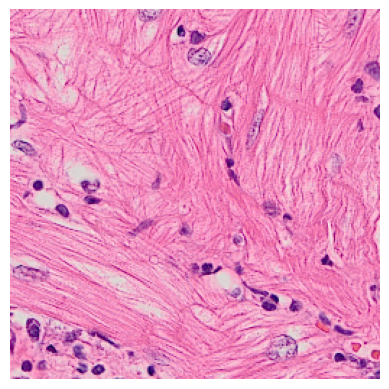

In [18]:
plt.imshow(cv2.cvtColor(np.load(file_list[3000])[:3].transpose(1,2,0), cv2.COLOR_LAB2RGB))
plt.axis('off')
plt.show()

In [21]:
np.load(file_list[3000])[3:7].shape

(4, 256, 256)

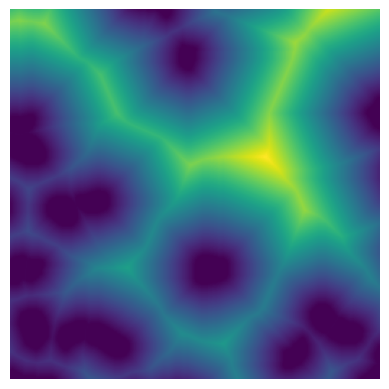

In [31]:
plt.imshow(np.load(file_list[3000])[6])
plt.axis('off')
plt.show()

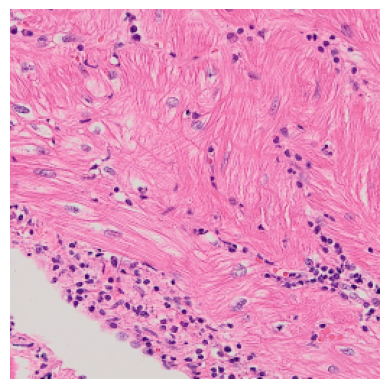

In [17]:
plt.imshow(cv2.cvtColor(np.load(file_list[3000])[7:].transpose(1,2,0), cv2.COLOR_LAB2RGB))
plt.axis('off')
plt.show()

In [11]:
%%time
# for idx in idx_list:
#     extract_multiclass_training_set(idx)

with Pool(9) as p:
    p.map(extract_multiclass_training_set, idx_list)

CPU times: total: 109 ms
Wall time: 3min 47s


## Multiclass supporting information training data - separately processed WSIs

In [74]:
# Output shape 5x256x256; RGB BG CLASS
# idx => corresponding .tif 
# x, y => upper-left corner coordinates
out_data_store = 'C:/IKEM_training_datasets/multilabeling_v2/{mode}/data/{idx}_x={x}_y={y}.npy'
out_label_store = 'C:/IKEM_training_datasets/multilabeling_v2/{mode}/labels/{idx}_x={x}_y={y}.npy'

def extract_multiclass_training_set(file, tiff=tiff, np=np, cv2=cv2, out_data_store=out_data_store, out_label_store=out_label_store, wsi_patt=wsi_patt, bg_patt=bg_patt, class_patt=class_patt, nuclei_patt=nuclei_patt, mode='train'):
    output = []
    window_size = 256
    stride = 128
    start_x, end_x, start_y, end_y = file[1], file[2], file[3], file[4]
    file = file[0]
    idx = int(file.split('_')[0])
    data = np.load(f'./test_data/cell/multiclass/{file}')

    wsi_data = data[:3, :, :].transpose((1, 2, 0))
    wsi_data = wsi_data.astype(np.float32) / 255
    wsi_data = cv2.cvtColor(wsi_data, cv2.COLOR_RGB2LAB)
    wsi_data = cv2.resize(wsi_data, (wsi_data.shape[1]//2, wsi_data.shape[0]//2))
    bg_data = data[3, :, :]
    bg_data = cv2.resize(bg_data, (bg_data.shape[1]//2, bg_data.shape[0]//2))
    class_data = np.load(class_patt.format(idx=idx))[:, start_x:end_x, start_y:end_y]
    class_data = cv2.resize(class_data.transpose(1, 2, 0), (class_data.shape[2]//2, class_data.shape[1]//2)).transpose(2, 0, 1)
    cell_data = data[5, :, :]
    
    cell_data_1 = np.where(cell_data == 1, 1, 0).astype(np.uint8)
    cell_data_2 = np.where(cell_data == 2, 1, 0).astype(np.uint8)
    cell_data_3 = np.where(cell_data == 3, 1, 0).astype(np.uint8)
    
    dst_data_1 = np.where(cell_data_1 == 1, 0, 1).astype(np.uint8)
    dst_data_2 = np.where(cell_data_2 == 1, 0, 1).astype(np.uint8)
    dst_data_3 = np.where(cell_data_3 == 1, 0, 1).astype(np.uint8)
    
    dst_1 = cv2.distanceTransform(dst_data_1, cv2.DIST_L2, 3)
    dst_2 = cv2.distanceTransform(dst_data_2, cv2.DIST_L2, 3)
    dst_3 = cv2.distanceTransform(dst_data_3, cv2.DIST_L2, 3)
    
    dst_1 = np.where(dst_1>255, 255, dst_1).astype(np.float32)
    dst_2 = np.where(dst_2>255, 255, dst_2).astype(np.float32)
    dst_3 = np.where(dst_3>255, 255, dst_3).astype(np.float32)
    
    dst_1 = cv2.resize(dst_1, (dst_1.shape[1]//2, dst_1.shape[0]//2))
    dst_2 = cv2.resize(dst_2, (dst_2.shape[1]//2, dst_2.shape[0]//2))
    dst_3 = cv2.resize(dst_3, (dst_3.shape[1]//2, dst_3.shape[0]//2))
    
    cell_data_1 = cv2.resize(cell_data_1, (cell_data_1.shape[1]//2, cell_data_1.shape[0]//2))
    cell_data_2 = cv2.resize(cell_data_2, (cell_data_2.shape[1]//2, cell_data_2.shape[0]//2))
    cell_data_3 = cv2.resize(cell_data_3, (cell_data_3.shape[1]//2, cell_data_3.shape[0]//2))
    
    splits = []
    for x in range(0, wsi_data.shape[0], stride):
        for y in range(0, wsi_data.shape[1], stride):
            if min(wsi_data.shape[1], y + window_size) - y != 256:
                y = 256 - (min(wsi_data.shape[1], y + window_size) - y)
            if min(wsi_data.shape[0], x + window_size) - x != 256:
                x = 256 - (min(wsi_data.shape[1], x + window_size) - x)
            
            if np.count_nonzero(bg_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]==0) >= 5000:
                out_arr = np.zeros((10, 256, 256))
                
                tmp_downscaled = wsi_data[max(0, x - window_size//2):min(wsi_data.shape[0], x + window_size  + window_size//2), max(0, y - window_size//2):min(wsi_data.shape[1], y + window_size + window_size//2)]
  
                p = np.shape(tmp_downscaled)
                max_h = window_size*2
                max_w = window_size*2
                pad_h = (max_h-p[0])
                pad_w = (max_w-p[1]) 
                
                if pad_h <= 0:
                    pad_h_b = np.abs(pad_h)
                    pad_h_a = 0
                else:
                    pad_h_b = 0
                    pad_h_a = pad_h
                    
                
                if pad_w <= 0:
                    pad_w_b = np.abs(pad_w)
                    pad_w_a = 0
                else:
                    pad_w_b = 0
                    pad_w_a = pad_w
                
                
                tmp_downscaled = cv2.copyMakeBorder(tmp_downscaled, pad_h_a, pad_h_b, pad_w_b, pad_w_a, cv2.BORDER_REFLECT)
                tmp_downscaled = cv2.resize(tmp_downscaled, (window_size, window_size))
                
                out_arr[:3, :, :] = np.transpose(wsi_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)], (2, 0, 1))
                out_arr[3, :, :] = bg_data[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[4, :, :] = dst_1[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[5, :, :] = dst_2[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[6, :, :] = dst_3[x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]
                out_arr[7:, :, :] = tmp_downscaled.transpose(2, 0, 1)
                
                with open(out_data_store.format(mode=mode, idx=idx, x=x, y=y), 'wb') as f:
                    np.save(f, out_arr.astype(np.float32))
                    
                with open(out_label_store.format(mode=mode, idx=idx, x=x, y=y), 'wb') as f:
                    np.save(f, class_data[:, x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)].astype(np.uint8))
                    
                if np.count_nonzero(class_data[1:, x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)]) >= 6553:
                    
                    with open(out_data_store.format(mode=mode, idx=f'{idx}_ver', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(out_arr.astype(np.float32), axis=1))
                    with open(out_label_store.format(mode=mode, idx=f'{idx}_ver', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(class_data[:, x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)].astype(np.uint8), axis=1))
                        
                    with open(out_data_store.format(mode=mode, idx=f'{idx}_hor', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(out_arr.astype(np.float32), axis=2))
                    with open(out_label_store.format(mode=mode, idx=f'{idx}_hor', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(class_data[:, x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)].astype(np.uint8), axis=2))
                        
                    with open(out_data_store.format(mode=mode, idx=f'{idx}_ver_hor', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(np.flip(out_arr.astype(np.float32), axis=1), axis=2))
                    with open(out_label_store.format(mode=mode, idx=f'{idx}_ver_hor', x=x, y=y), 'wb') as f:
                        np.save(f, np.flip(np.flip(class_data[:, x:min(wsi_data.shape[0], x + window_size), y:min(wsi_data.shape[1], y + window_size)].astype(np.uint8), axis=1), axis=2))    
    return output

In [75]:
file_list = [('2724_part_1.npy', 500, 3000, 500, 4000),
             ('2724_part_2.npy', 1000, 7000, 6000, 15000),
             ('2724_part_3.npy', 3000, 8000, 14500, 23000),
             ('2724_part_4.npy', 1000, 7000, 22500, 29000),
             ('2724_part_5.npy', 3500, 9000, 29000, 38000),
             ('2724_part_6.npy', 3500, 9000, 29000, 38000),
             ('2940_part_1.npy', 500, 8000, 500, 9000),
             ('2940_part_2.npy', 500, 8000, 13000, 21000),
             ('2940_part_3.npy', 500, 8000, 13000, 21000),
             ('2940_part_4.npy', 500, 8000, 13000, 21000)]

In [76]:
%%time
# for file in os.listdir('F:/Halinkovic/IKEM/test_data/cell/multiclass'):
#     extract_multiclass_training_set(file)

with Pool(16) as p:
    p.map(extract_multiclass_training_set, file_list)

CPU times: total: 141 ms
Wall time: 1min 26s


## Scaler preparation

In [77]:
to_remove = []
for file in glob('C:/IKEM_training_datasets/multilabeling_v2/train/labels/*.npy'):
    tmp = np.load(file).size
    
    if tmp < 300000:
        to_remove.append(file)


In [80]:
for file in to_remove:
    os.remove('C:/IKEM_training_datasets/multilabeling_v2/train/data/' + file.split('\\')[-1])
    os.remove('C:/IKEM_training_datasets/multilabeling_v2/train/labels/' + file.split('\\')[-1])

In [2]:
%%time
scaler_data_l = np.empty(shape=(len(glob('C:/IKEM_training_datasets/multilabeling_v1/train/data/*.npy')), 256, 256))
for idx, file in enumerate(glob('C:/IKEM_training_datasets/multilabeling_v1/train/data/*.npy')):
    tmp_file = np.load(file)
    scaler_data_l[idx, :, :] = tmp_file[0]
    
scaler_data_l = scaler_data_l.astype(np.float32)
scaler = StandardScaler().fit(scaler_data_l.reshape(-1, 1))
joblib.dump(scaler, "C:/IKEM_training_datasets/multilabeling_v1/scalers/L_scaler.joblib")

del scaler_data_l

CPU times: total: 2min 36s
Wall time: 6min 41s


In [3]:
%%time
scaler_data_a = np.empty(shape=(len(glob('C:/IKEM_training_datasets/multilabeling_v1/train/data/*.npy')), 256, 256))
for idx, file in enumerate(glob('C:/IKEM_training_datasets/multilabeling_v1/train/data/*.npy')):
    tmp_file = np.load(file)
    scaler_data_a[idx, :, :] = tmp_file[1]
    
scaler_data_a = scaler_data_a.astype(np.float32)
scaler = StandardScaler().fit(scaler_data_a.reshape(-1, 1))
joblib.dump(scaler, "C:/IKEM_training_datasets/multilabeling_v1/scalers/A_scaler.joblib")

del scaler_data_a

CPU times: total: 2min 37s
Wall time: 7min 35s


In [4]:
%%time
scaler_data_b = np.empty(shape=(len(glob('C:/IKEM_training_datasets/multilabeling_v1/train/data/*.npy')), 256, 256))
for idx, file in enumerate(glob('C:/IKEM_training_datasets/multilabeling_v1/train/data/*.npy')):
    tmp_file = np.load(file)
    scaler_data_b[idx, :, :] = tmp_file[2]
    
scaler_data_b = scaler_data_b.astype(np.float32)
scaler = StandardScaler().fit(scaler_data_b.reshape(-1, 1))
joblib.dump(scaler, "C:/IKEM_training_datasets/multilabeling_v1/scalers/B_scaler.joblib")

del scaler_data_b

CPU times: total: 2min 38s
Wall time: 7min 36s


In [44]:
%%time
scaler_data_1 = np.empty(shape=(len(glob('C:/IKEM_training_datasets/multilabeling_v1/train/data/*.npy')), 256, 256))
for idx, file in enumerate(glob('C:/IKEM_training_datasets/multilabeling_v1/train/data/*.npy')):
    tmp_file = np.load(file)
    scaler_data_1[idx, :, :] = tmp_file[5]
    
scaler_data_1 = scaler_data_1.astype(np.float32)
scaler = StandardScaler().fit(scaler_data_1.reshape(-1, 1))
joblib.dump(scaler, "C:/IKEM_training_datasets/multilabeling_v1/scalers/multiclass_dst1_scaler.joblib")

del scaler_data_1

CPU times: total: 3min 1s
Wall time: 8min 2s


In [45]:
%%time
scaler_data_2 = np.empty(shape=(len(glob('C:/IKEM_training_datasets/multilabeling_v1/train/data/*.npy')), 256, 256))
for idx, file in enumerate(glob('C:/IKEM_training_datasets/multilabeling_v1/train/data/*.npy')):
    tmp_file = np.load(file)
    scaler_data_2[idx, :, :] = tmp_file[7]
    
scaler_data_2 = scaler_data_2.astype(np.float32)
scaler = StandardScaler().fit(scaler_data_2.reshape(-1, 1))
joblib.dump(scaler, "C:/IKEM_training_datasets/multilabeling_v1/scalers/multiclass_dst2_scaler.joblib")

del scaler_data_2

CPU times: total: 2min 53s
Wall time: 7min 56s


In [46]:
%%time
scaler_data_3 = np.empty(shape=(len(glob('C:/IKEM_training_datasets/multilabeling_v1/train/data/*.npy')), 256, 256))
for idx, file in enumerate(glob('C:/IKEM_training_datasets/multilabeling_v1/train/data/*.npy')):
    tmp_file = np.load(file)
    scaler_data_3[idx, :, :] = tmp_file[9]
    
scaler_data_3 = scaler_data_3.astype(np.float32)
scaler = StandardScaler().fit(scaler_data_3.reshape(-1, 1))
joblib.dump(scaler, "C:/IKEM_training_datasets/multilabeling_v1/scalers/multiclass_dst3_scaler.joblib")

del scaler_data_3

CPU times: total: 3min 8s
Wall time: 8min 20s


# Test data - all models

The following script prepares testing data for multiple usecases

The thinking process behind this form of data processing is different. We do not create patch-level datasets, but instead just filter out whole tissue samples.
The goal is to simulate a real use-case where we might be forced to work with images of varying sizes. 

We do not use whole WSIs and instead just focus on separating out individual slices of tissue to reduce the memory requirements and to not store large amounts of useless background pixels.

The block numbers below correspond to the ID number of each WSI that's processed for testing.

In [5]:
wsi_patt = './raw_data/tif_export/{idx}-test.tif'
bg_patt = './raw_data/bg_masks/{idx}-test_bg.npy'
class_patt = './raw_data/class_masks/{idx}-test_classes.npy'
cell_patt = './raw_data/cell_masks/{idx}_cells.npy'

In [6]:
idx_list = [int(idx.split('-')[0]) for idx in os.listdir('./raw_data/tif_export') if 'test' in idx] 

In [41]:
wsi = tiff.imread(wsi_patt.format(idx=idx_list[0]))

### 2724

In [7]:
wsi_patt = './raw_data/tif_export/{idx}.ome.tif'
bg_patt = './raw_data/bg_masks/{idx}_bg.npy'
class_patt = './raw_data/class_masks/{idx}_classes.npy'

In [8]:
wsi_data = tiff.imread(wsi_patt.format(idx=2724))
bg_data = np.load(bg_patt.format(idx=2724))
class_data = np.load(class_patt.format(idx=2724))

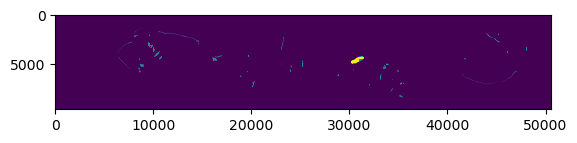

In [9]:
plt.imshow(class_data)

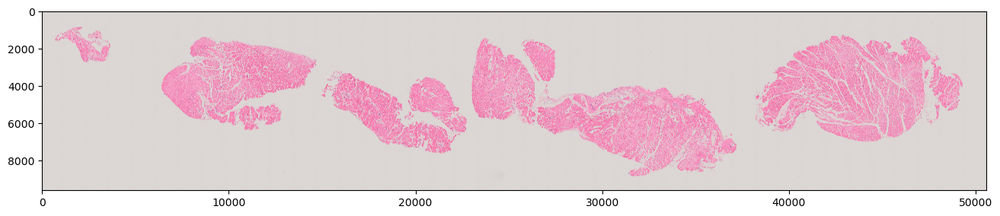

In [80]:
plt.figure(figsize=(16,12))
plt.imshow(wsi_data[:, :, :])

In [83]:
out_store = './test_data/cell/binary/2724_part_1.npy'

out_arr = np.zeros((6, 2500, 3500))
out_arr[:3, :, :] = np.transpose(wsi_data[500:3000, 500:4000], (2, 0, 1))
out_arr[3, :, :] = bg_data[500:3000, 500:4000]
out_arr[4, :, :] = class_data[500:3000, 500:4000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

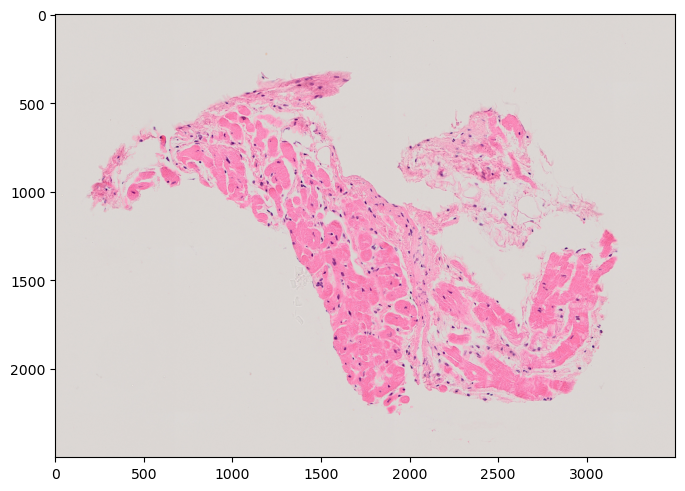

In [82]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[500:3000, 500:4000, :])

In [91]:
out_store = './test_data/cell/binary/2724_part_2.npy'

out_arr = np.zeros((6, 6000, 9000))
out_arr[:3, :, :] = np.transpose(wsi_data[1000:7000, 6000:15000, :], (2, 0, 1))
out_arr[3, :, :] = bg_data[1000:7000, 6000:15000]
out_arr[4, :, :] = class_data[1000:7000, 6000:15000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

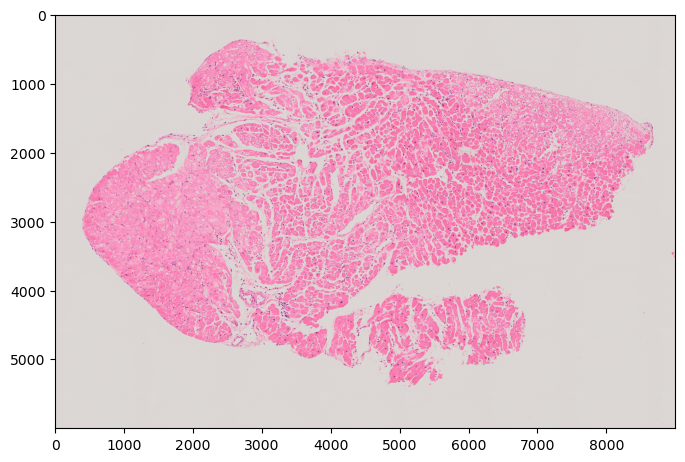

In [86]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[1000:7000, 6000:15000, :])

In [94]:
out_store = './test_data/cell/binary/2724_part_3.npy'

out_arr = np.zeros((6, 5000, 8500))
out_arr[:3, :, :] = np.transpose(wsi_data[3000:8000, 14500:23000, :], (2, 0, 1))
out_arr[3, :, :] = bg_data[3000:8000, 14500:23000]
out_arr[4, :, :] = class_data[3000:8000, 14500:23000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

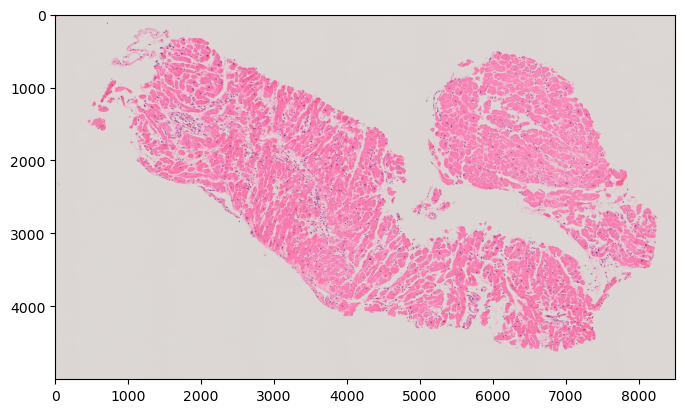

In [93]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[3000:8000, 14500:23000, :])

In [102]:
out_store = './test_data/cell/binary/2724_part_4.npy'

out_arr = np.zeros((6, 6000, 6500))
out_arr[:3, :, :] = np.transpose(wsi_data[1000:7000, 22500:29000, :], (2, 0, 1))
out_arr[3, :, :] = bg_data[1000:7000, 22500:29000]
out_arr[4, :, :] = class_data[1000:7000, 22500:29000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

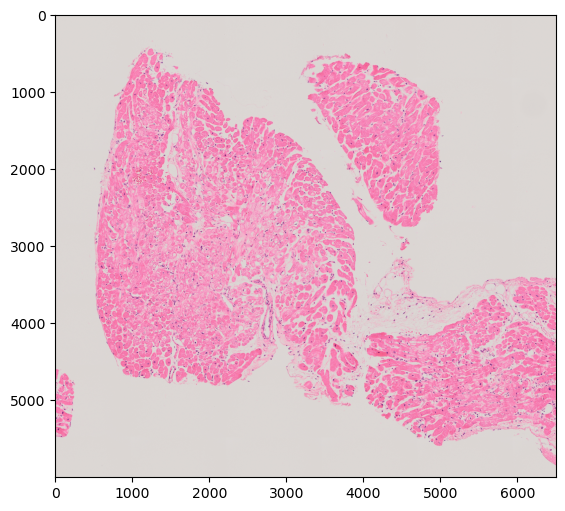

In [101]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[1000:7000, 22500:29000, :])

In [106]:
out_store = './test_data/cell/binary/2724_part_5.npy'

out_arr = np.zeros((6, 5500, 9000))
out_arr[:3, :, :] = np.transpose(wsi_data[3500:9000, 29000:38000, :], (2, 0, 1))
out_arr[3, :, :] = bg_data[3500:9000, 29000:38000]
out_arr[4, :, :] = class_data[3500:9000, 29000:38000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

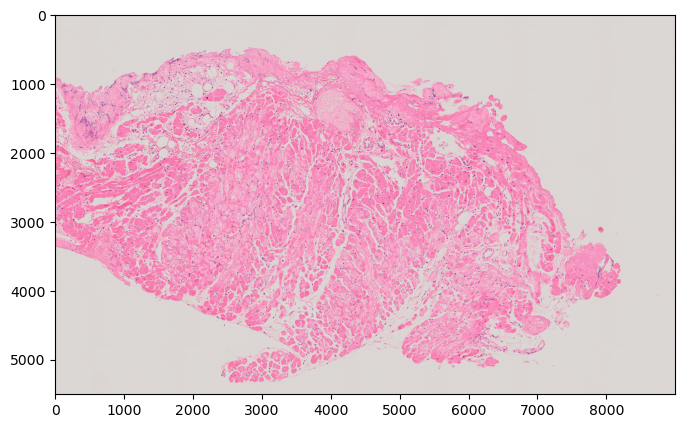

In [105]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[3500:9000, 29000:38000, :])

In [111]:
out_store = './test_data/cell/binary/2724_part_6.npy'

out_arr = np.zeros((6, 6000, 11000))
out_arr[:3, :, :] = np.transpose(wsi_data[1000:7000, 38500:49500, :], (2, 0, 1))
out_arr[3, :, :] = bg_data[1000:7000, 38500:49500]
out_arr[4, :, :] = class_data[1000:7000, 38500:49500]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

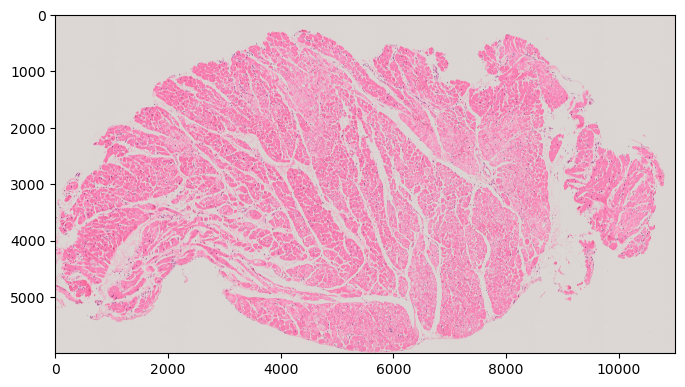

In [110]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[1000:7000, 38500:49500, :])

### 2940

In [112]:
wsi_data = tiff.imread(wsi_patt.format(idx=2940))
bg_data = np.load(bg_patt.format(idx=2940))
class_data = np.load(class_patt.format(idx=2940))

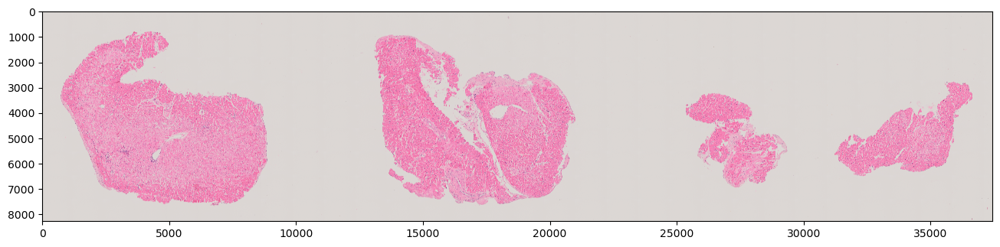

In [113]:
plt.figure(figsize=(16,12))
plt.imshow(wsi_data[:, :, :])

In [117]:
out_store = './test_data/cell/binary/2940_part_1.npy'

out_arr = np.zeros((6, 7500, 8500))
out_arr[:3, :, :] = np.transpose(wsi_data[500:8000, 500:9000], (2, 0, 1))
out_arr[3, :, :] = bg_data[500:8000, 500:9000]
out_arr[4, :, :] = class_data[500:8000, 500:9000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

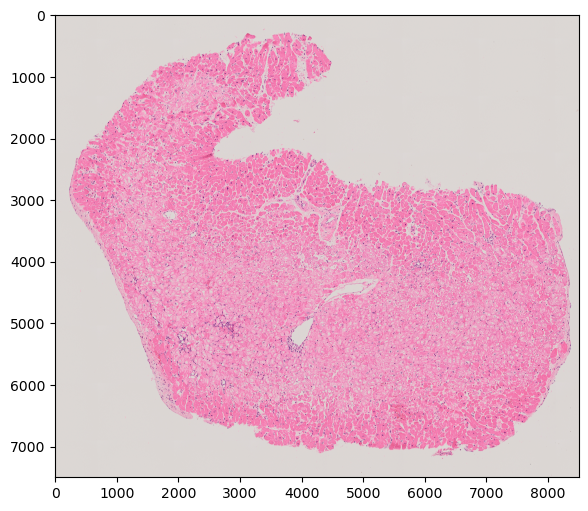

In [116]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[500:8000, 500:9000, :])

In [120]:
out_store = './test_data/cell/binary/2940_part_2.npy'

out_arr = np.zeros((6, 7500, 8000))
out_arr[:3, :, :] = np.transpose(wsi_data[500:8000, 13000:21000], (2, 0, 1))
out_arr[3, :, :] = bg_data[500:8000, 13000:21000]
out_arr[4, :, :] = class_data[500:8000, 13000:21000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

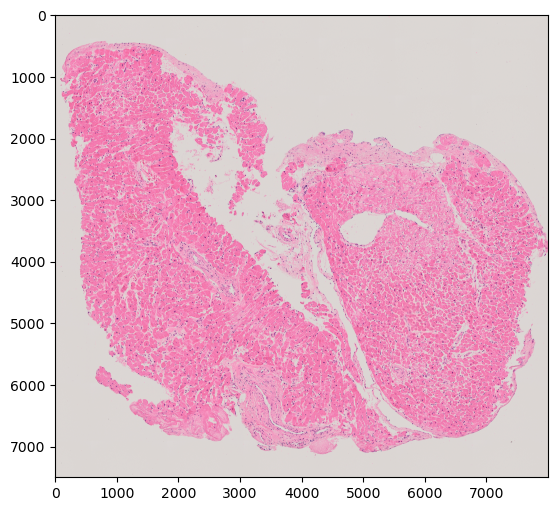

In [119]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[500:8000, 13000:21000, :])

In [123]:
out_store = './test_data/cell/binary/2940_part_3.npy'

out_arr = np.zeros((6, 4000, 4500))
out_arr[:3, :, :] = np.transpose(wsi_data[3000:7000, 25000:29500], (2, 0, 1))
out_arr[3, :, :] = bg_data[3000:7000, 25000:29500]
out_arr[4, :, :] = class_data[3000:7000, 25000:29500]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

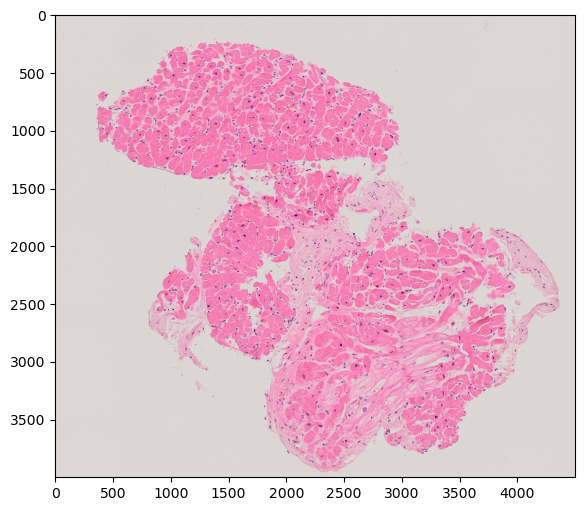

In [122]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[3000:7000, 25000:29500, :])

In [125]:
out_store = './test_data/cell/binary/2940_part_4.npy'

out_arr = np.zeros((6, 4000, 6000))
out_arr[:3, :, :] = np.transpose(wsi_data[2500:6500, 31000:37000], (2, 0, 1))
out_arr[3, :, :] = bg_data[2500:6500, 31000:37000]
out_arr[4, :, :] = class_data[2500:6500, 31000:37000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

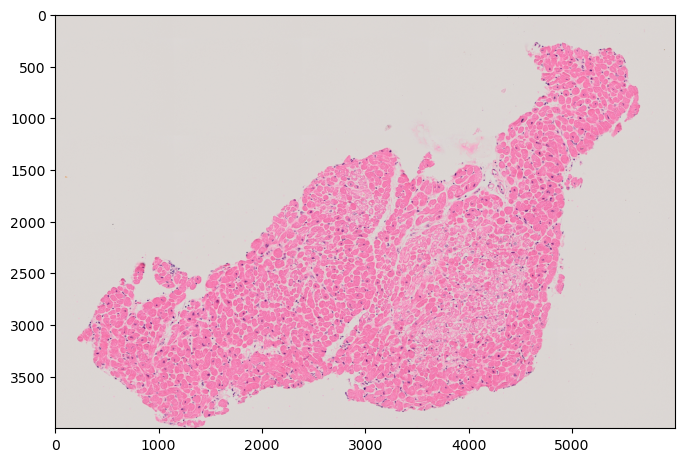

In [124]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[2500:6500, 31000:37000, :])

### 3002

In [11]:
wsi_patt = './raw_data/tif_export/{idx}-test.tif'
bg_patt = './raw_data/bg_masks/{idx}-test_bg.npy'
class_patt = './raw_data/class_masks_fix/{idx}-test_classes.npy'
cell_patt = './raw_data/cell_masks/{idx}_cells.npy'

In [12]:
wsi_data = tiff.imread(wsi_patt.format(idx=3002))
bg_data = np.load(bg_patt.format(idx=3002))
class_data = np.load(class_patt.format(idx=3002))
cell_data = np.load(cell_patt.format(idx=3002))

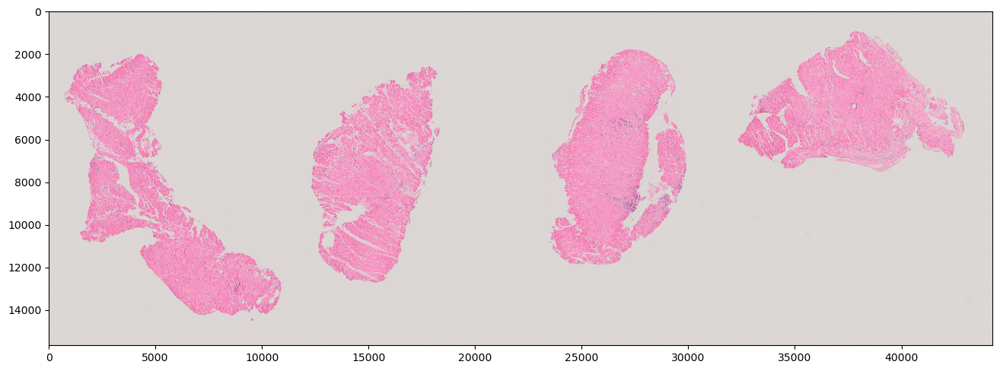

In [14]:
plt.figure(figsize=(16,12))
plt.imshow(wsi_data[:, :, :])

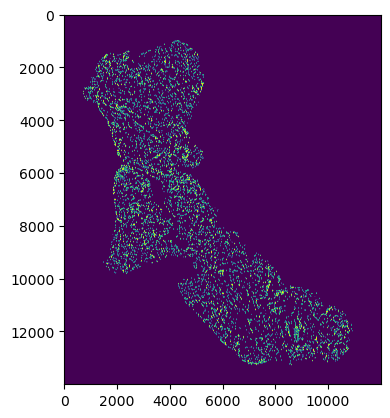

In [15]:
plt.imshow(out_arr[5])
plt.show()

In [10]:
out_store = './test_data/cell_src/3002_part_1.npy'

out_arr = np.zeros((6, 14000, 12000))
out_arr[:3, :, :] = np.transpose(wsi_data[1000:15000, 0:12000], (2, 0, 1))
out_arr[3, :, :] = bg_data[1000:15000, 0:12000]
out_arr[4, :, :] = class_data[1000:15000, 0:12000]
out_arr[5, :, :] = cell_data[1000:15000, 0:12000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

ValueError: could not broadcast input array from shape (3,8586,12000) into shape (3,14000,12000)

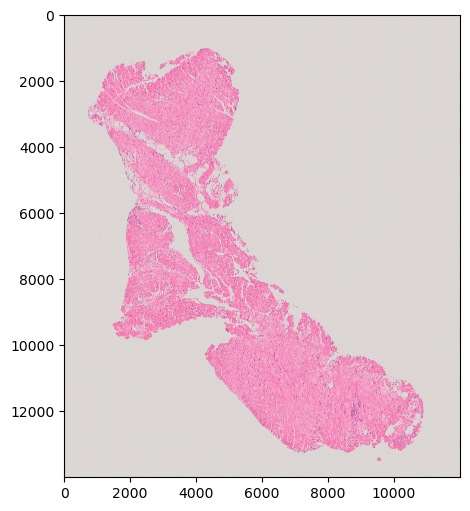

In [16]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[1000:15000, 0:12000, :])

In [17]:
out_store = './test_data/cell_src/3002_part_2.npy'

out_arr = np.zeros((6, 11000, 7000))
out_arr[:3, :, :] = np.transpose(wsi_data[2000:13000, 12000:19000, :], (2, 0, 1))
out_arr[3, :, :] = bg_data[2000:13000, 12000:19000]
out_arr[4, :, :] = class_data[2000:13000, 12000:19000]
out_arr[5, :, :] = cell_data[2000:13000, 12000:19000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

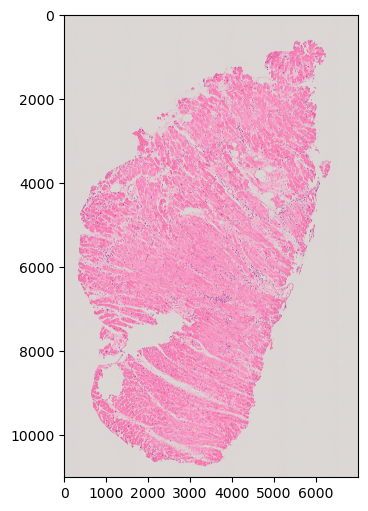

In [18]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[2000:13000, 12000:19000, :])

In [19]:
out_store = './test_data/cell_src/3002_part_3.npy'

out_arr = np.zeros((6, 12000, 9000))
out_arr[:3, :, :] = np.transpose(wsi_data[1000:13000, 22000:31000], (2, 0, 1))
out_arr[3, :, :] = bg_data[1000:13000, 22000:31000]
out_arr[4, :, :] = class_data[1000:13000, 22000:31000]
out_arr[5, :, :] = cell_data[1000:13000, 22000:31000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

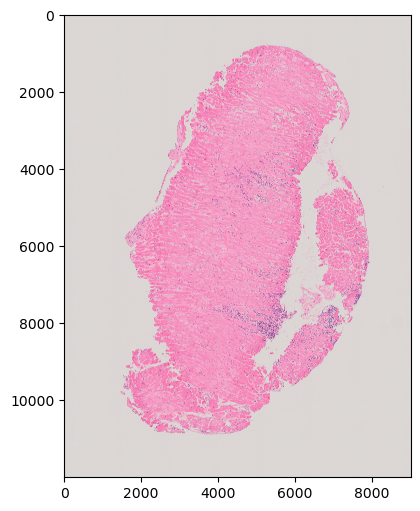

In [20]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[1000:13000, 22000:31000, :])

In [21]:
out_store = './test_data/cell_src/3002_part_4.npy'

out_arr = np.zeros((6, 9000, 13000))
out_arr[:3, :, :] = np.transpose(wsi_data[0:9000, 31000:44000], (2, 0, 1))
out_arr[3, :, :] = bg_data[0:9000, 31000:44000]
out_arr[4, :, :] = class_data[0:9000, 31000:44000]
out_arr[5, :, :] = cell_data[0:9000, 31000:44000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

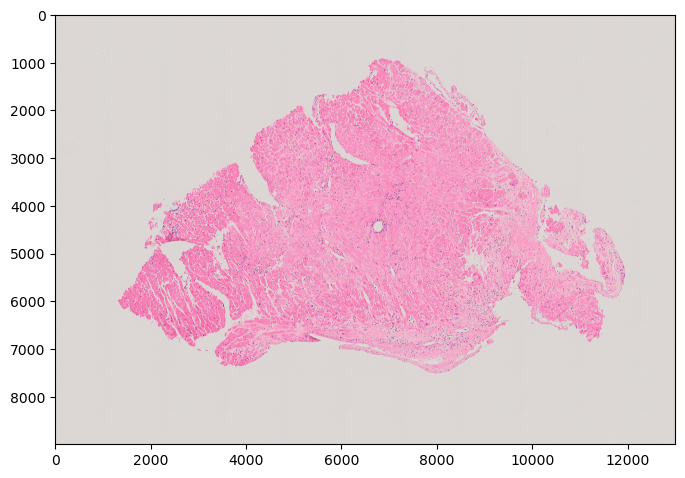

In [22]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[0:9000, 31000:44000, :])

### 7026

In [23]:
wsi_patt = './raw_data/tif_export/{idx}-test.tif'
bg_patt = './raw_data/bg_masks/{idx}-test_bg.npy'
class_patt = './raw_data/class_masks_fix/{idx}-test_classes.npy'
cell_patt = './raw_data/cell_masks/{idx}_cells.npy'

In [24]:
wsi_data = tiff.imread(wsi_patt.format(idx=7026))
bg_data = np.load(bg_patt.format(idx=7026))
class_data = np.load(class_patt.format(idx=7026))
cell_data = np.load(cell_patt.format(idx=7026))

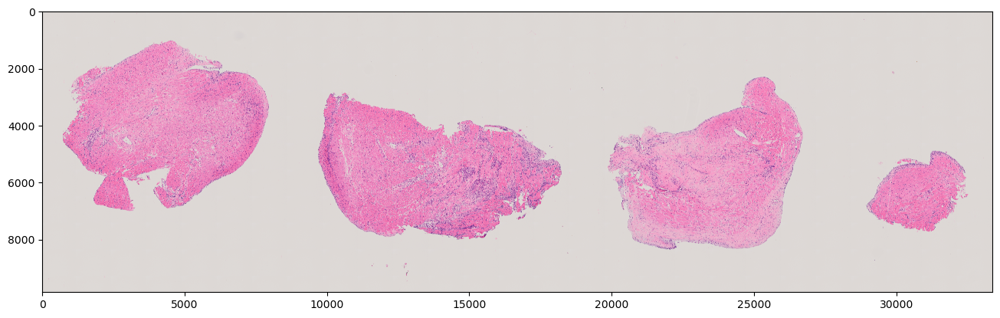

In [25]:
plt.figure(figsize=(16,12))
plt.imshow(wsi_data[:, :, :])

In [26]:
out_store = './test_data/cell_src/7026_part_1.npy'

out_arr = np.zeros((6, 7500, 8000))
out_arr[:3, :, :] = np.transpose(wsi_data[0:7500, 0:8000], (2, 0, 1))
out_arr[3, :, :] = bg_data[0:7500, 0:8000]
out_arr[4, :, :] = class_data[0:7500, 0:8000]
out_arr[5, :, :] = cell_data[0:7500, 0:8000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

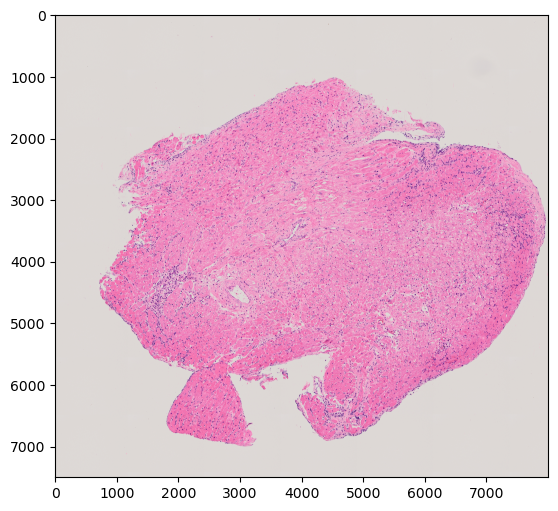

In [27]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[0:7500, 0:8000, :])

In [28]:
out_store = './test_data/cell_src/7026_part_2.npy'

out_arr = np.zeros((6, 6000, 9000))
out_arr[:3, :, :] = np.transpose(wsi_data[2500:8500, 9500:18500, :], (2, 0, 1))
out_arr[3, :, :] = bg_data[2500:8500, 9500:18500]
out_arr[4, :, :] = class_data[2500:8500, 9500:18500]
out_arr[5, :, :] = cell_data[2500:8500, 9500:18500]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

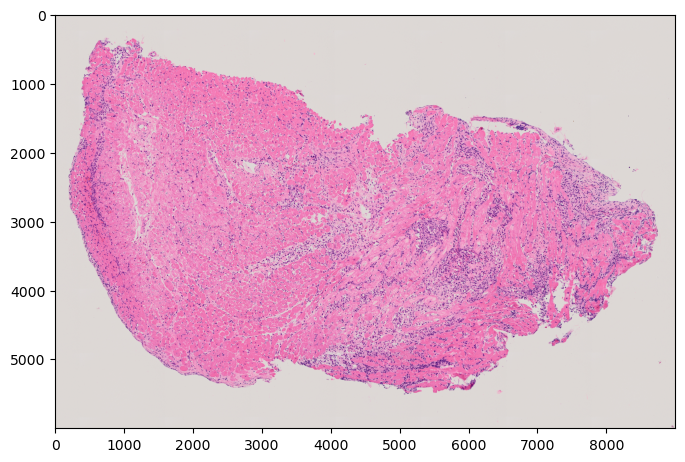

In [29]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[2500:8500, 9500:18500, :])

In [30]:
out_store = './test_data/cell_src/7026_part_3.npy'

out_arr = np.zeros((6, 7000, 8000))
out_arr[:3, :, :] = np.transpose(wsi_data[2000:9000, 19000:27000], (2, 0, 1))
out_arr[3, :, :] = bg_data[2000:9000, 19000:27000]
out_arr[4, :, :] = class_data[2000:9000, 19000:27000]
out_arr[5, :, :] = cell_data[2000:9000, 19000:27000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

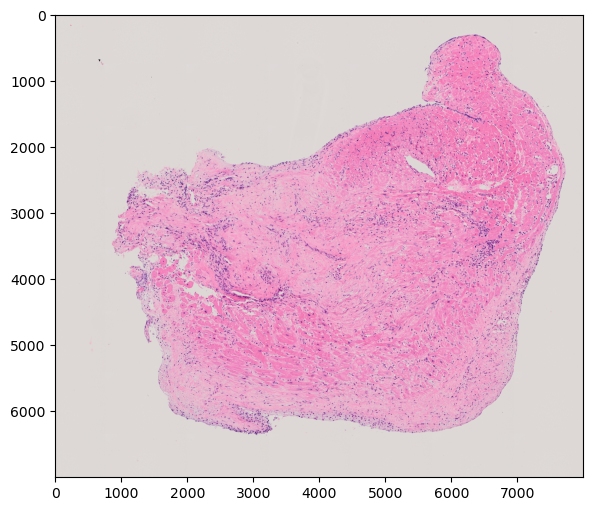

In [31]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[2000:9000, 19000:27000, :])

In [32]:
out_store = './test_data/cell_src/7026_part_4.npy'

out_arr = np.zeros((6, 3500, 4500))
out_arr[:3, :, :] = np.transpose(wsi_data[4500:8000, 28500:33000], (2, 0, 1))
out_arr[3, :, :] = bg_data[4500:8000, 28500:33000]
out_arr[4, :, :] = class_data[4500:8000, 28500:33000]
out_arr[5, :, :] = cell_data[4500:8000, 28500:33000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))

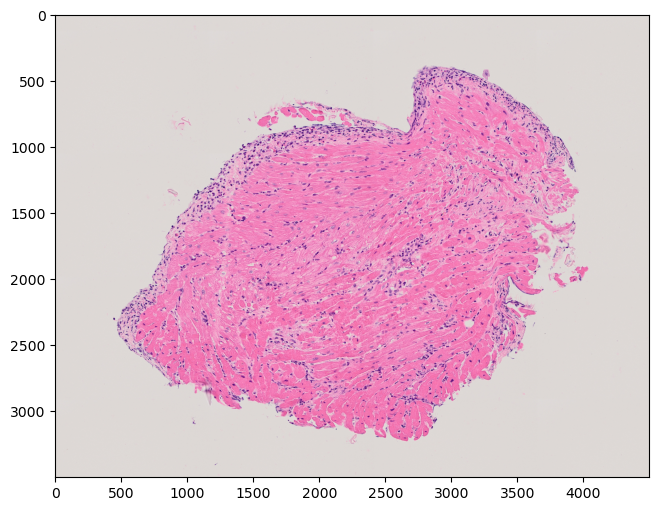

In [33]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[4500:8000, 28500:33000, :])

### 3002 - multilabel

In [48]:
wsi_patt = './raw_data/tif_export/{idx}-test.tif'
bg_patt = './raw_data/bg_masks/{idx}-test_bg.npy'
class_patt = './raw_data/class_masks_multilabel/{idx}_classes.npy'
cell_patt = './raw_data/cell_masks/{idx}_cells.npy'

In [49]:
wsi_data = tiff.imread(wsi_patt.format(idx=3002))
bg_data = np.load(bg_patt.format(idx=3002))
class_data = np.load(class_patt.format(idx=3002))
cell_data = np.load(cell_patt.format(idx=3002))

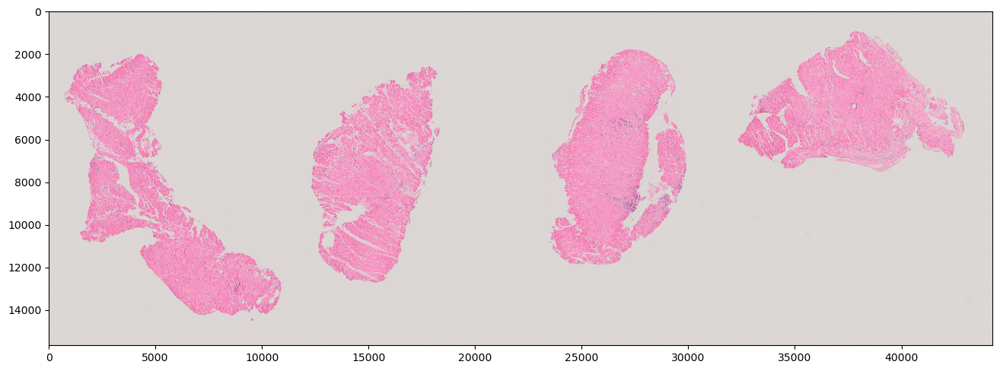

In [7]:
plt.figure(figsize=(16,12))
plt.imshow(wsi_data[:, :, :])

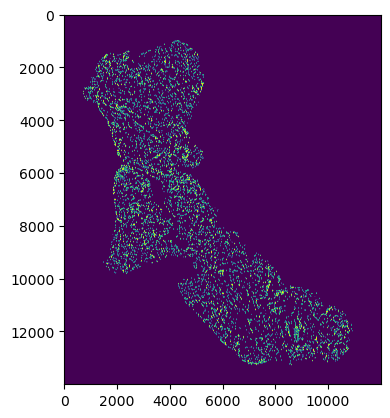

In [15]:
plt.imshow(out_arr[5])
plt.show()

In [30]:
out_data_store = './test_data/multilabel/3002_part_1.npy'
out_label_store = './test_data/multilabel/3002_part_1_labels.npy'

out_arr = np.zeros((5, 14000, 12000))
out_label_arr = np.zeros((5, 14000, 12000))
out_arr[:3, :, :] = np.transpose(wsi_data[1000:15000, 0:12000], (2, 0, 1))
out_arr[3, :, :] = bg_data[1000:15000, 0:12000]
out_arr[4, :, :] = cell_data[1000:15000, 0:12000]

out_label_arr[:, :, :] = class_data[:, 1000:15000, 0:12000]

with open(out_data_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))
with open(out_label_store, 'wb') as f:
    np.save(f, out_label_arr.astype(np.uint8))

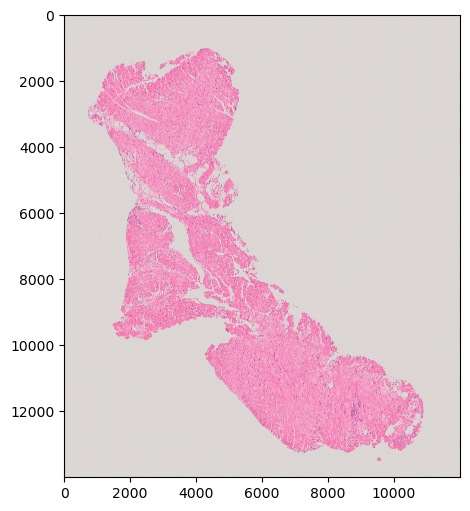

In [16]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[1000:15000, 0:12000, :])

In [31]:
out_data_store = './test_data/multilabel/3002_part_2.npy'
out_labels_store = './test_data/multilabel/3002_part_2_labels.npy'

out_arr = np.zeros((5, 11000, 7000))
out_label_arr = np.zeros((5, 11000, 7000))
out_arr[:3, :, :] = np.transpose(wsi_data[2000:13000, 12000:19000, :], (2, 0, 1))
out_arr[3, :, :] = bg_data[2000:13000, 12000:19000]
out_arr[4, :, :] = cell_data[2000:13000, 12000:19000]

out_label_arr[:, :, :] = class_data[:, 2000:13000, 12000:19000]

with open(out_data_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))
with open(out_labels_store, 'wb') as f:
    np.save(f, out_label_arr.astype(np.uint8))

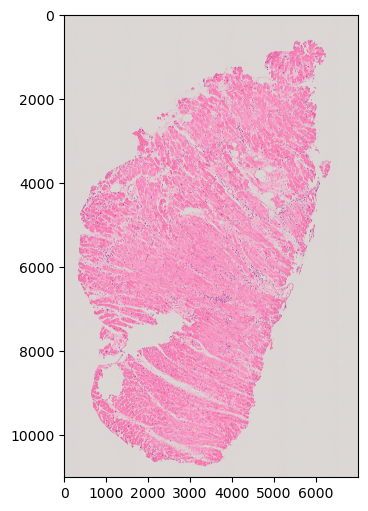

In [18]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[2000:13000, 12000:19000, :])

In [32]:
out_data_store = './test_data/multilabel/3002_part_3.npy'
out_label_store = './test_data/multilabel/3002_part_3_labels.npy'

out_arr = np.zeros((5, 12000, 9000))
out_label_arr = np.zeros((5, 12000, 9000))
out_arr[:3, :, :] = np.transpose(wsi_data[1000:13000, 22000:31000], (2, 0, 1))
out_arr[3, :, :] = bg_data[1000:13000, 22000:31000]
out_arr[4, :, :] = cell_data[1000:13000, 22000:31000]

out_label_arr[:, :, :] = class_data[:, 1000:13000, 22000:31000]

with open(out_data_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))
with open(out_label_store, 'wb') as f:
    np.save(f, out_label_arr.astype(np.uint8))

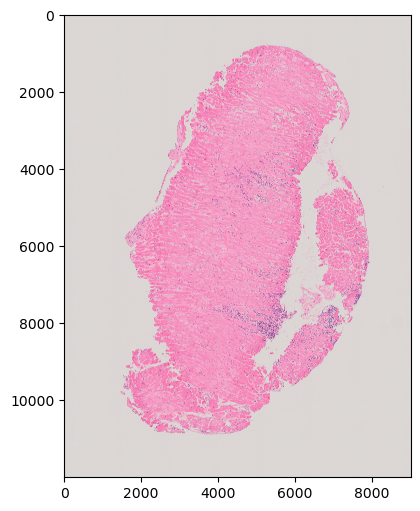

In [20]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[1000:13000, 22000:31000, :])

In [50]:
out_data_store = './test_data/multilabel/3002_part_4.npy'
out_label_store = './test_data/multilabel/3002_part_4_labels.npy'

out_arr = np.zeros((5, 9000, 13000))
out_label_arr = np.zeros((5, 9000, 13000))
out_arr[:3, :, :] = np.transpose(wsi_data[0:9000, 31000:44000], (2, 0, 1))
out_arr[3, :, :] = bg_data[0:9000, 31000:44000]
out_arr[4, :, :] = cell_data[0:9000, 31000:44000]

out_label_arr[:, :, :] = class_data[:, 0:9000, 31000:44000]

with open(out_data_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))
with open(out_label_store, 'wb') as f:
    np.save(f, out_label_arr.astype(np.uint8))

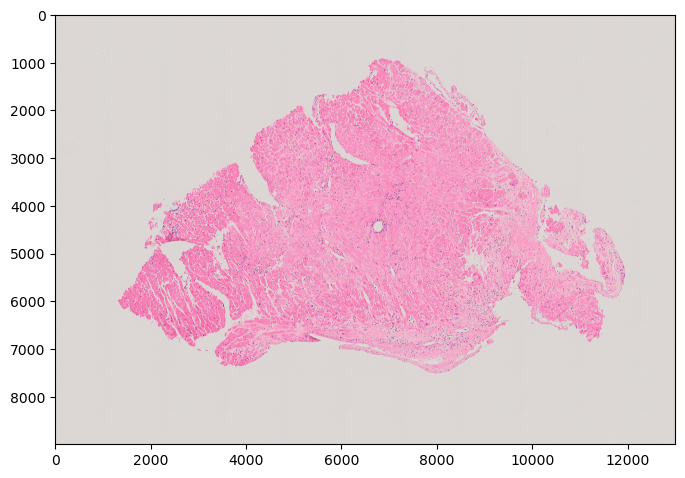

In [22]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[0:9000, 31000:44000, :])

### 7026 - multilabel

In [34]:
wsi_patt = './raw_data/tif_export/{idx}-test.tif'
bg_patt = './raw_data/bg_masks/{idx}-test_bg.npy'
class_patt = './raw_data/class_masks_multilabel/{idx}_classes.npy'
cell_patt = './raw_data/cell_masks/{idx}_cells.npy'

In [35]:
wsi_data = tiff.imread(wsi_patt.format(idx=7026))
bg_data = np.load(bg_patt.format(idx=7026))
class_data = np.load(class_patt.format(idx=7026))
cell_data = np.load(cell_patt.format(idx=7026))

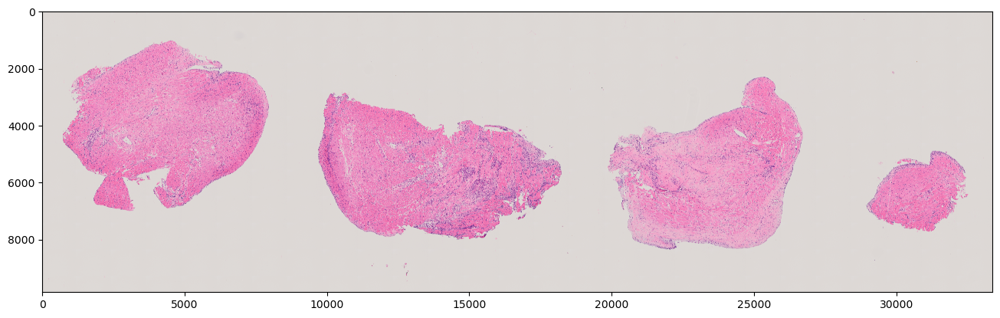

In [25]:
plt.figure(figsize=(16,12))
plt.imshow(wsi_data[:, :, :])

In [36]:
out_data_store = './test_data/multilabel/7026_part_1.npy'
out_label_store = './test_data/multilabel/7026_part_1_labels.npy'

out_arr = np.zeros((5, 7500, 8000))
out_label_arr = np.zeros((5, 7500, 8000))

out_arr[:3, :, :] = np.transpose(wsi_data[0:7500, 0:8000], (2, 0, 1))
out_arr[3, :, :] = bg_data[0:7500, 0:8000]
out_arr[4, :, :] = cell_data[0:7500, 0:8000]

out_label_arr[:, :, :] = class_data[:, 0:7500, 0:8000]

with open(out_data_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))
with open(out_label_store, 'wb') as f:
    np.save(f, out_label_arr.astype(np.uint8))

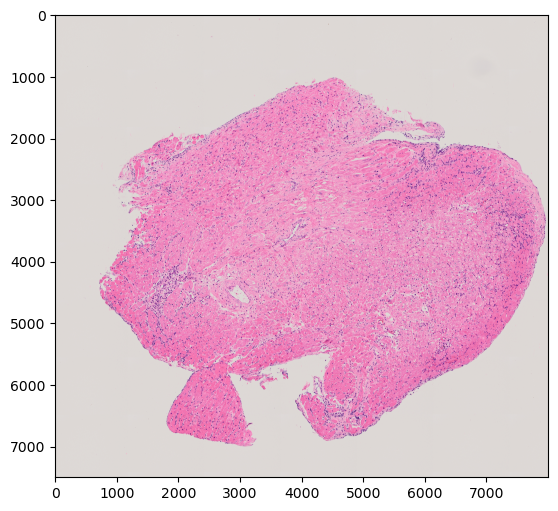

In [27]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[0:7500, 0:8000, :])

In [37]:
out_store = './test_data/multilabel/7026_part_2.npy'
out_label_store = './test_data/multilabel/7026_part_2_labels.npy'

out_arr = np.zeros((5, 6000, 9000))
out_label_arr = np.zeros((5, 6000, 9000))

out_arr[:3, :, :] = np.transpose(wsi_data[2500:8500, 9500:18500, :], (2, 0, 1))
out_arr[3, :, :] = bg_data[2500:8500, 9500:18500]
out_arr[4, :, :] = cell_data[2500:8500, 9500:18500]

out_label_arr[:, :, :] = class_data[:, 2500:8500, 9500:18500]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))
with open(out_label_store, 'wb') as f:
    np.save(f, out_label_arr.astype(np.uint8))

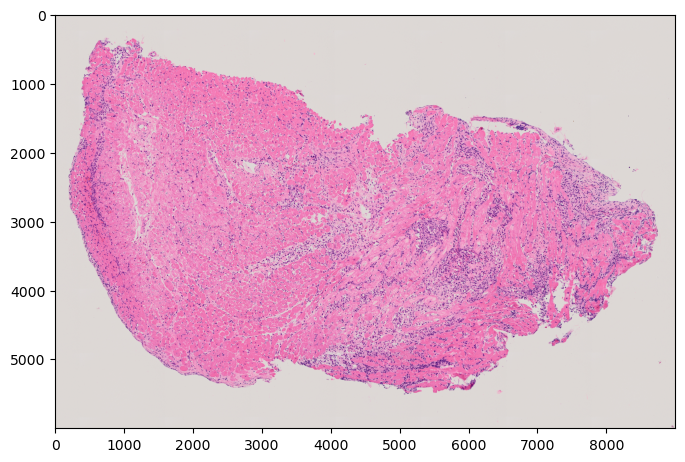

In [29]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[2500:8500, 9500:18500, :])

In [38]:
out_store = './test_data/multilabel/7026_part_3.npy'
out_label_store = './test_data/multilabel/7026_part_3_labels.npy'

out_arr = np.zeros((5, 7000, 8000))
out_label_arr = np.zeros((5, 7000, 8000))
out_arr[:3, :, :] = np.transpose(wsi_data[2000:9000, 19000:27000], (2, 0, 1))
out_arr[3, :, :] = bg_data[2000:9000, 19000:27000]
out_arr[4, :, :] = cell_data[2000:9000, 19000:27000]

out_label_arr[:, :, :] = class_data[:, 2000:9000, 19000:27000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))
with open(out_label_store, 'wb') as f:
    np.save(f, out_label_arr.astype(np.uint8))

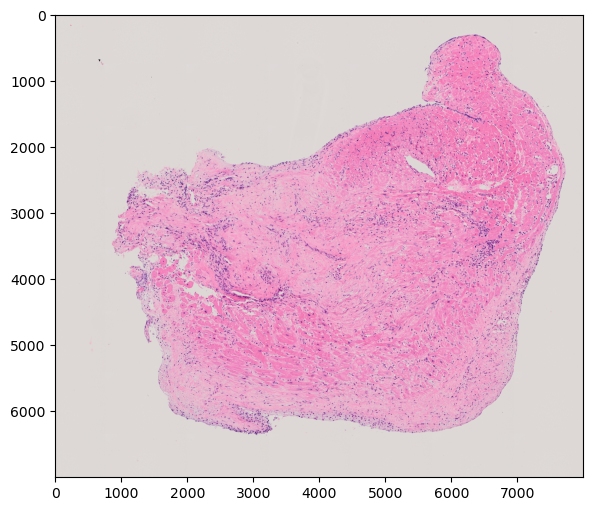

In [31]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[2000:9000, 19000:27000, :])

In [39]:
out_store = './test_data/multilabel/7026_part_4.npy'
out_label_store = './test_data/multilabel/7026_part_4_labels.npy'

out_arr = np.zeros((5, 3500, 4500))
out_label_arr = np.zeros((5, 3500, 4500))
out_arr[:3, :, :] = np.transpose(wsi_data[4500:8000, 28500:33000], (2, 0, 1))
out_arr[3, :, :] = bg_data[4500:8000, 28500:33000]
out_arr[4, :, :] = cell_data[4500:8000, 28500:33000]

out_label_arr[:, :, :] = class_data[:, 4500:8000, 28500:33000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))
with open(out_label_store, 'wb') as f:
    np.save(f, out_label_arr.astype(np.uint8))

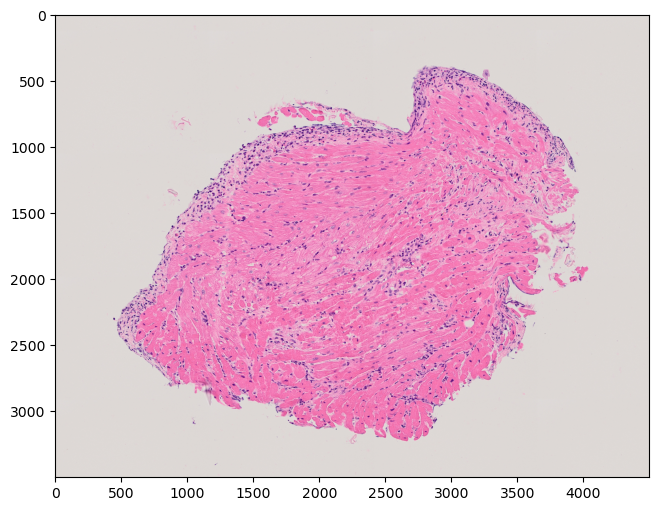

In [33]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[4500:8000, 28500:33000, :])

### 5312 - multilabel

In [5]:
wsi_patt = './raw_data/tif_export/{idx}.ome.tif'
bg_patt = './raw_data/bg_masks/{idx}_bg.npy'
class_patt = './raw_data/class_masks_multilabel/{idx}_classes.npy'
cell_patt = './raw_data/cell_masks/{idx}_cells.npy'

In [6]:
wsi_data = tiff.imread(wsi_patt.format(idx=5312))
bg_data = np.load(bg_patt.format(idx=5312))
class_data = np.load(class_patt.format(idx=5312))
cell_data = np.load(cell_patt.format(idx=5312))

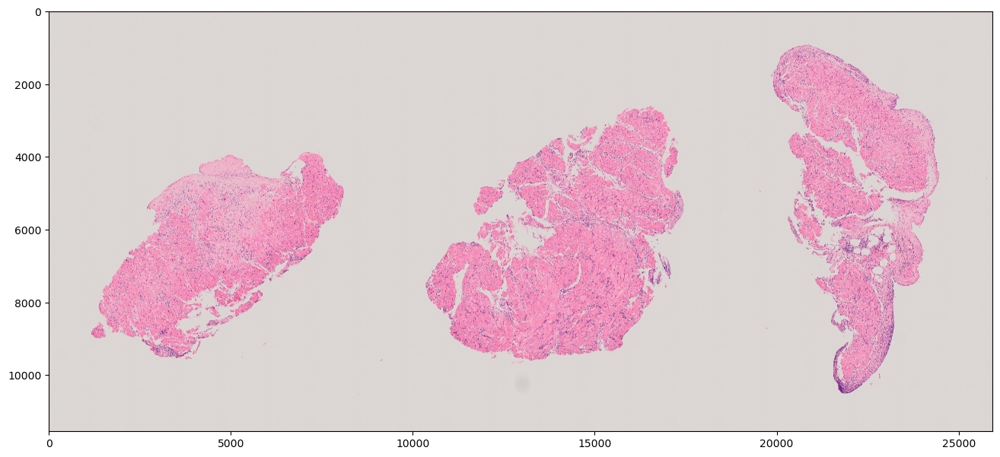

In [7]:
plt.figure(figsize=(16,12))
plt.imshow(wsi_data[:, :, :])

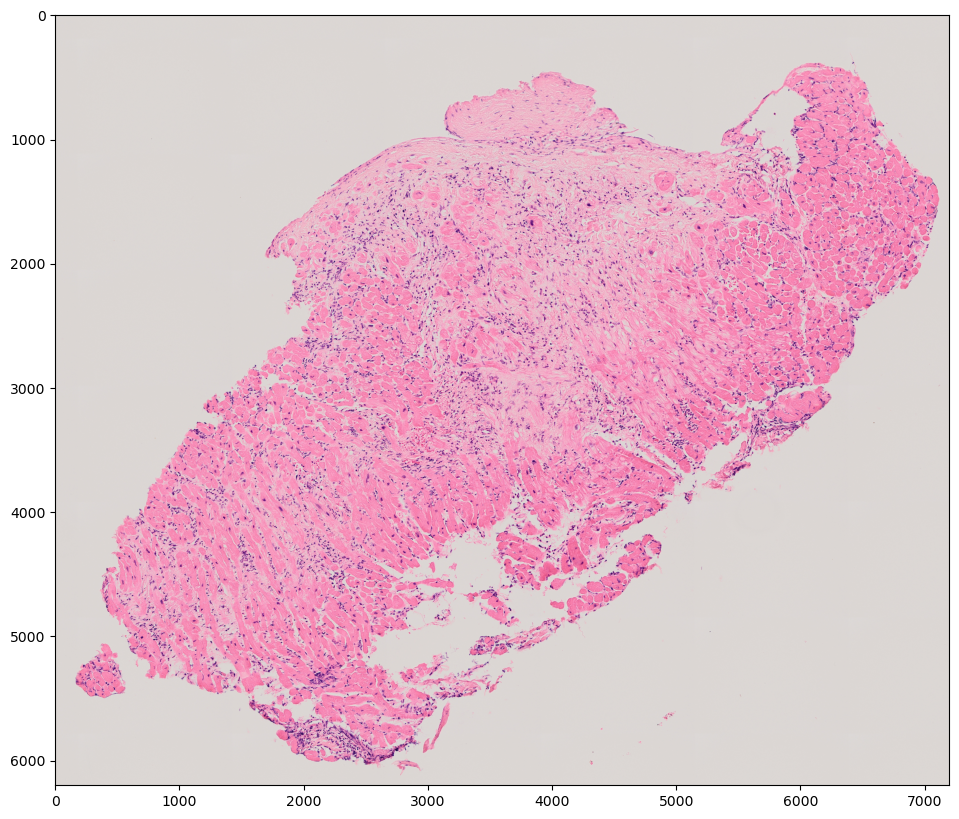

In [13]:
plt.figure(figsize=(13,10))
plt.imshow(wsi_data[3500:9700, 1000:8200, :])

In [14]:
out_data_store = './test_data/multilabel/5312_part_1.npy'
out_label_store = './test_data/multilabel/5312_part_1_labels.npy'

out_arr = np.zeros((5, 6200, 7200))
out_label_arr = np.zeros((5, 6200, 7200))

out_arr[:3, :, :] = np.transpose(wsi_data[3500:9700, 1000:8200], (2, 0, 1))
out_arr[3, :, :] = bg_data[3500:9700, 1000:8200]
out_arr[4, :, :] = cell_data[3500:9700, 1000:8200]

out_label_arr[:, :, :] = class_data[:,3500:9700, 1000:8200]

with open(out_data_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))
with open(out_label_store, 'wb') as f:
    np.save(f, out_label_arr.astype(np.uint8))

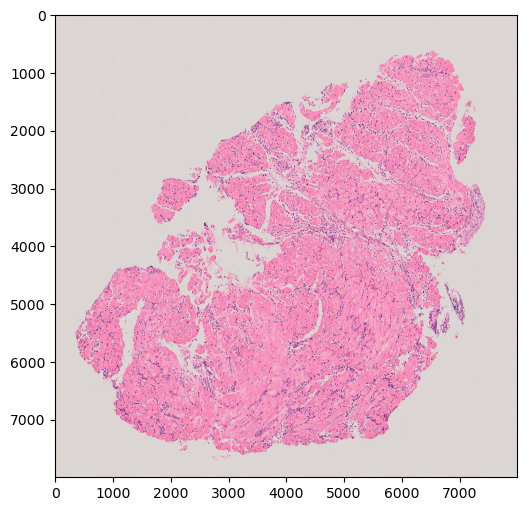

In [19]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[2000:10000, 10000:18000, :])

In [ ]:
out_store = './test_data/multilabel/5312_part_2.npy'
out_label_store = './test_data/multilabel/5312_part_2_labels.npy'

out_arr = np.zeros((5, 8000, 8000))
out_label_arr = np.zeros((5, 8000, 8000))

out_arr[:3, :, :] = np.transpose(wsi_data[2000:10000, 10000:18000, :], (2, 0, 1))
out_arr[3, :, :] = bg_data[2000:10000, 10000:18000]
out_arr[4, :, :] = cell_data[2000:10000, 10000:18000]

out_label_arr[:, :, :] = class_data[:, 2000:10000, 10000:18000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))
with open(out_label_store, 'wb') as f:
    np.save(f, out_label_arr.astype(np.uint8))

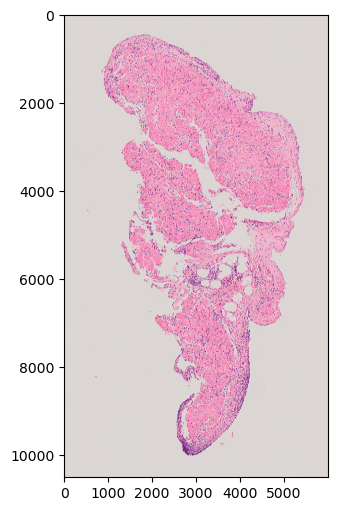

In [20]:
plt.figure(figsize=(8,6))
plt.imshow(wsi_data[500:11000, 19000:25000, :])

In [21]:
out_store = './test_data/multilabel/5312_part_3.npy'
out_label_store = './test_data/multilabel/5312_part_3_labels.npy'

out_arr = np.zeros((5, 10500, 6000))
out_label_arr = np.zeros((5, 10500, 6000))
out_arr[:3, :, :] = np.transpose(wsi_data[500:11000, 19000:25000], (2, 0, 1))
out_arr[3, :, :] = bg_data[500:11000, 19000:25000]
out_arr[4, :, :] = cell_data[500:11000, 19000:25000]

out_label_arr[:, :, :] = class_data[:, 500:11000, 19000:25000]

with open(out_store, 'wb') as f:
    np.save(f, out_arr.astype(np.uint8))
with open(out_label_store, 'wb') as f:
    np.save(f, out_label_arr.astype(np.uint8))